<a href="https://colab.research.google.com/github/DevByIsaac/TesisCheckListOCRA/blob/main/Tesis_ModeloOCRA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install MediaPipe

In [ ]:
!pip install opencv-python

In [ ]:
# Importar librerías necesarias
import cv2
import numpy as np
import pandas as pd
import mediapipe as mp
from google.colab import drive
import os

In [ ]:
drive.mount('/content/drive')
video_dir = '/content/drive/My Drive/VideosErgo/VideoTest'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Función para cargar los videos desde Google Drive
def load_videos(video_dir):
    videos = []
    for filename in os.listdir(video_dir):
        if filename.endswith(".mp4"):
            videos.append(os.path.join(video_dir, filename))
    return videos

In [ ]:
# Cargar videos
videos = load_videos(video_dir)

# Función para extraer frames de los videos
def extract_frames(video_path, interval=30):
    cap = cv2.VideoCapture(video_path)
    frames = []
    count = 0
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        if count % interval == 0:
            frames.append(frame)
        count += 1
    cap.release()
    return frames

# Obtener el nombre del primer video en la lista
video_name = os.path.basename(videos[0])
print(video_name)
# Extraer frames de un video (por ejemplo, el primer video de la lista)
frames = extract_frames(videos[0], interval=30)


etiquetado.mp4


In [ ]:
# Inicializar MediaPipe para detección de puntos clave
'''mp_drawing = mp.solutions.drawing_utils
mp_pose = mp.solutions.pose

# Función para detectar puntos clave usando MediaPipe
def detect_keypoints(frames):
    pose = mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5)
    keypoints_list = []
    for frame in frames:
        image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        results = pose.process(image_rgb)
        if results.pose_landmarks:
            keypoints = [(lm.x, lm.y, lm.z) for lm in results.pose_landmarks.landmark]
            keypoints_list.append(keypoints)
    pose.close()
    return keypoints_list

# Detectar puntos clave en los frames extraídos
keypoints = detect_keypoints(frames)

# Función para visualizar los puntos clave en los frames
from google.colab.patches import cv2_imshow

def draw_keypoints(frames, keypoints):
    pose = mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5)
    for i, frame in enumerate(frames):
        image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        results = pose.process(image_rgb)
        if results.pose_landmarks:
            mp_drawing.draw_landmarks(frame, results.pose_landmarks, mp_pose.POSE_CONNECTIONS)
        cv2_imshow(frame)

# Visualizar puntos clave en los frames
draw_keypoints(frames, keypoints)'''

'mp_drawing = mp.solutions.drawing_utils\nmp_pose = mp.solutions.pose\n\n# Función para detectar puntos clave usando MediaPipe\ndef detect_keypoints(frames):\n    pose = mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5)\n    keypoints_list = []\n    for frame in frames:\n        image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)\n        results = pose.process(image_rgb)\n        if results.pose_landmarks:\n            keypoints = [(lm.x, lm.y, lm.z) for lm in results.pose_landmarks.landmark]\n            keypoints_list.append(keypoints)\n    pose.close()\n    return keypoints_list\n\n# Detectar puntos clave en los frames extraídos\nkeypoints = detect_keypoints(frames)\n\n# Función para visualizar los puntos clave en los frames\nfrom google.colab.patches import cv2_imshow\n\ndef draw_keypoints(frames, keypoints):\n    pose = mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5)\n    for i, frame in enumerate(frames):\n        image_rgb = cv2.cvtColor(frame

In [ ]:
'''import cv2
import mediapipe as mp
import numpy as np

# Inicializar MediaPipe para detección de puntos clave
mp_drawing = mp.solutions.drawing_utils
mp_pose = mp.solutions.pose

# Función para calcular el ángulo entre tres puntos
def calculate_angle(a, b, c):
    a = np.array(a)  # Primer punto
    b = np.array(b)  # Segundo punto (vértice)
    c = np.array(c)  # Tercer punto

    radians = np.arctan2(c[1] - b[1], c[0] - b[0]) - np.arctan2(a[1] - b[1], a[0] - b[0])
    angle = np.abs(radians * 180.0 / np.pi)

    if angle > 180.0:
        angle = 360.0 - angle

    return angle

# Función para detectar puntos clave usando MediaPipe
def detect_keypoints(frames):
    pose = mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5)
    keypoints_list = []
    for frame in frames:
        image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        results = pose.process(image_rgb)
        if results.pose_landmarks:
            keypoints = [(lm.x, lm.y, lm.z) for lm in results.pose_landmarks.landmark]
            keypoints_list.append(keypoints)
    pose.close()
    return keypoints_list

# Función para extraer puntos clave específicos y calcular ángulos
def analyze_keypoints(keypoints_list):
    analysis_results = []
    for keypoints in keypoints_list:
        # Extraer puntos clave
        shoulder = keypoints[mp_pose.PoseLandmark.LEFT_SHOULDER.value]
        elbow = keypoints[mp_pose.PoseLandmark.LEFT_ELBOW.value]
        wrist = keypoints[mp_pose.PoseLandmark.LEFT_WRIST.value]
        hand = keypoints[mp_pose.PoseLandmark.LEFT_INDEX.value]

        # Calcular ángulos
        shoulder_angle = calculate_angle(shoulder, elbow, wrist)
        elbow_angle = calculate_angle(elbow, wrist, hand)

        analysis_results.append({
            'shoulder_angle': shoulder_angle,
            'elbow_angle': elbow_angle,
            'wrist_position': wrist,
            'hand_position': hand,
            'keypoints': keypoints
        })

    return analysis_results

# Detectar puntos clave en los frames extraídos
keypoints = detect_keypoints(frames)

# Analizar puntos clave y calcular ángulos
analysis_results = analyze_keypoints(keypoints)

# Función para visualizar los puntos clave en los frames
from google.colab.patches import cv2_imshow

def draw_keypoints_and_angles(frames, analysis_results):
    for i, frame in enumerate(frames):
        keypoints = analysis_results[i]['keypoints']
        shoulder_angle = analysis_results[i]['shoulder_angle']
        elbow_angle = analysis_results[i]['elbow_angle']

        # Dibujar puntos clave y conexiones con el color original
        if keypoints:
            for j, point in enumerate(keypoints):
                cv2.circle(frame, (int(point[0] * frame.shape[1]), int(point[1] * frame.shape[0])), 5, (0, 255, 0), -1)

                # Añadir texto con información relevante junto a cada punto
                info_text = ""
                if j == mp_pose.PoseLandmark.LEFT_SHOULDER.value:
                    info_text = f"Shoulder Angle: {int(shoulder_angle)}"
                elif j == mp_pose.PoseLandmark.LEFT_ELBOW.value:
                    info_text = f"Elbow Angle: {int(elbow_angle)}"
                elif j == mp_pose.PoseLandmark.LEFT_WRIST.value:
                    info_text = f"Wrist Pos: ({int(point[0] * frame.shape[1])}, {int(point[1] * frame.shape[0])})"
                elif j == mp_pose.PoseLandmark.LEFT_INDEX.value:
                    info_text = f"Hand Pos: ({int(point[0] * frame.shape[1])}, {int(point[1] * frame.shape[0])})"

                if info_text:
                    cv2.putText(frame, info_text,
                                (int(point[0] * frame.shape[1]) + 10, int(point[1] * frame.shape[0]) - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1, cv2.LINE_AA)

        # Dibujar ángulos en el frame
        cv2.putText(frame, f'Shoulder Angle: {int(shoulder_angle)}',
                    (10, 30),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2, cv2.LINE_AA)

        cv2.putText(frame, f'Elbow Angle: {int(elbow_angle)}',
                    (10, 70),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2, cv2.LINE_AA)

        cv2_imshow(frame)

        # Imprimir información relevante en la consola
        print(f"Frame {i+1}:")
        print(f"  Shoulder Angle: {shoulder_angle}")
        print(f"  Elbow Angle: {elbow_angle}")
        print(f"  Wrist Position: {analysis_results[i]['wrist_position']}")
        print(f"  Hand Position: {analysis_results[i]['hand_position']}")
        print()

# Visualizar puntos clave y ángulos en los frames
draw_keypoints_and_angles(frames, analysis_results)'''

'import cv2\nimport mediapipe as mp\nimport numpy as np\n\n# Inicializar MediaPipe para detección de puntos clave\nmp_drawing = mp.solutions.drawing_utils\nmp_pose = mp.solutions.pose\n\n# Función para calcular el ángulo entre tres puntos\ndef calculate_angle(a, b, c):\n    a = np.array(a)  # Primer punto\n    b = np.array(b)  # Segundo punto (vértice)\n    c = np.array(c)  # Tercer punto\n\n    radians = np.arctan2(c[1] - b[1], c[0] - b[0]) - np.arctan2(a[1] - b[1], a[0] - b[0])\n    angle = np.abs(radians * 180.0 / np.pi)\n    \n    if angle > 180.0:\n        angle = 360.0 - angle\n        \n    return angle\n\n# Función para detectar puntos clave usando MediaPipe\ndef detect_keypoints(frames):\n    pose = mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5)\n    keypoints_list = []\n    for frame in frames:\n        image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)\n        results = pose.process(image_rgb)\n        if results.pose_landmarks:\n            keypoints = 

/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


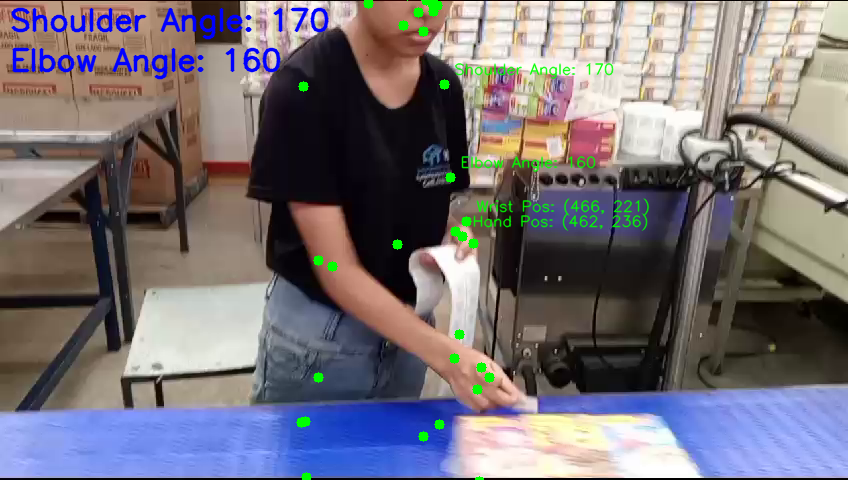

Frame 1:
  Shoulder Angle: 170.46677591522382
  Elbow Angle: 160.47129332880738
  Wrist Position: (0.5501465201377869, 0.461285799741745, -0.5445539951324463)
  Hand Position: (0.5457249879837036, 0.49350425601005554, -0.6114274263381958)



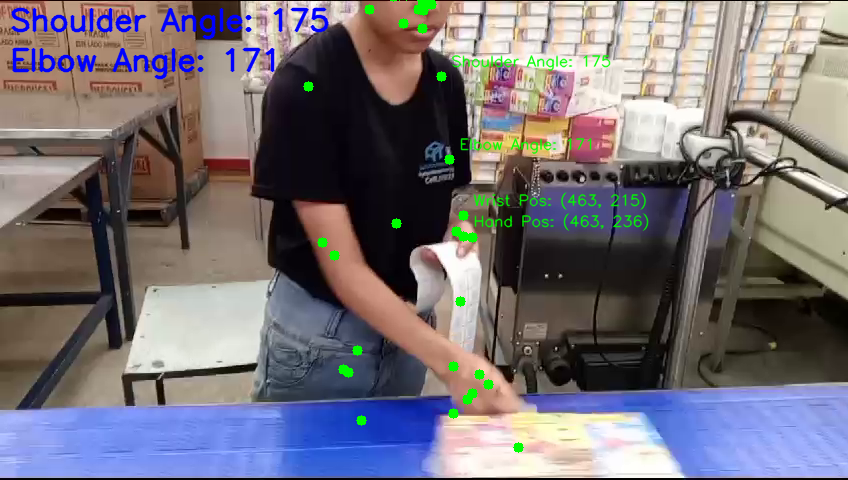

Frame 2:
  Shoulder Angle: 175.15211534274349
  Elbow Angle: 171.441056234745
  Wrist Position: (0.54688960313797, 0.4487461447715759, -0.21103188395500183)
  Hand Position: (0.5464873313903809, 0.49320003390312195, -0.25287556648254395)



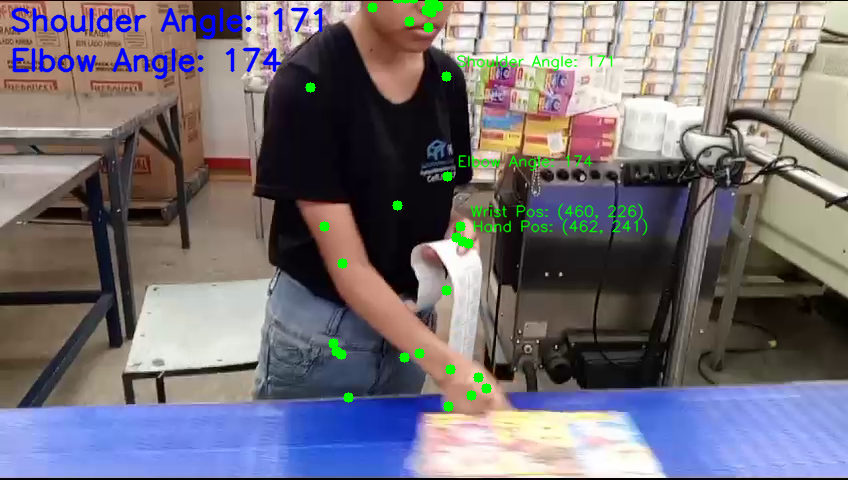

Frame 3:
  Shoulder Angle: 171.8002942387409
  Elbow Angle: 174.40916431695697
  Wrist Position: (0.543535590171814, 0.47137248516082764, -0.438538521528244)
  Hand Position: (0.5451216697692871, 0.5023550987243652, -0.4940272867679596)



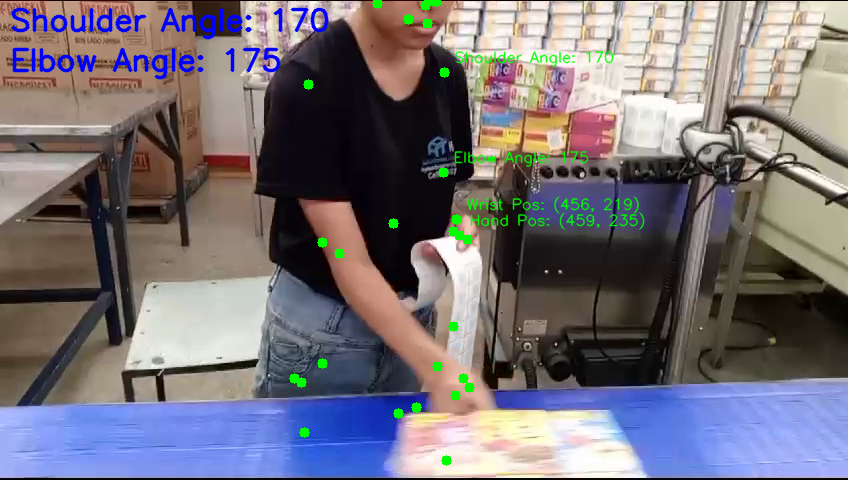

Frame 4:
  Shoulder Angle: 170.1176654561065
  Elbow Angle: 175.09408067116306
  Wrist Position: (0.5387303829193115, 0.45686233043670654, -0.2268066257238388)
  Hand Position: (0.541425347328186, 0.49072593450546265, -0.2623036503791809)



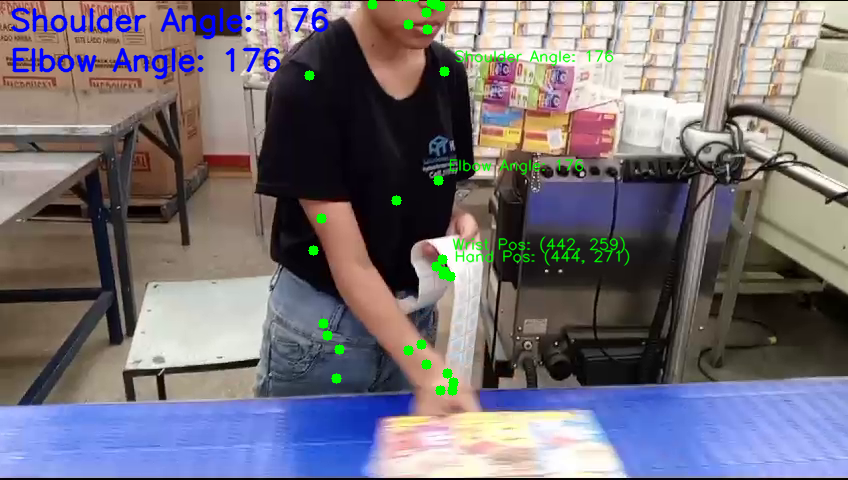

Frame 5:
  Shoulder Angle: 176.4717221986944
  Elbow Angle: 176.37981608307177
  Wrist Position: (0.5218833088874817, 0.5399798154830933, -0.41362854838371277)
  Hand Position: (0.5242016911506653, 0.5647335052490234, -0.4595862030982971)



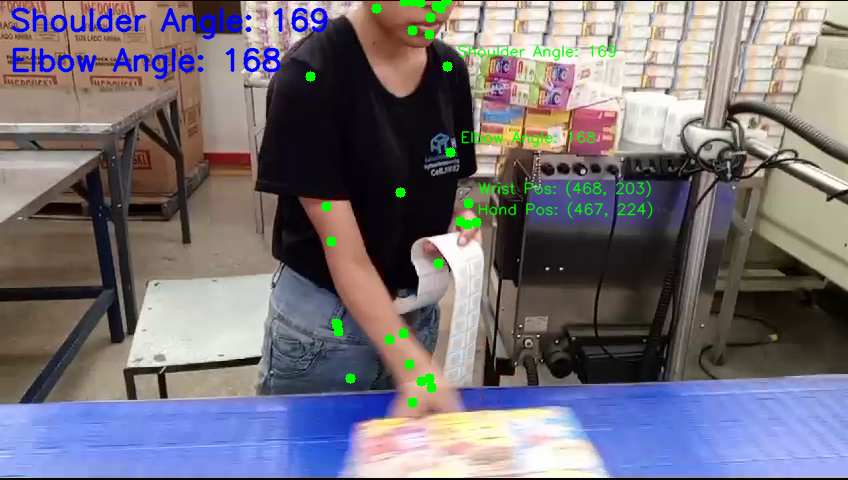

Frame 6:
  Shoulder Angle: 169.86321774224274
  Elbow Angle: 168.21104952717403
  Wrist Position: (0.5520963072776794, 0.4232722520828247, -0.16909445822238922)
  Hand Position: (0.55165696144104, 0.4684615731239319, -0.18939939141273499)



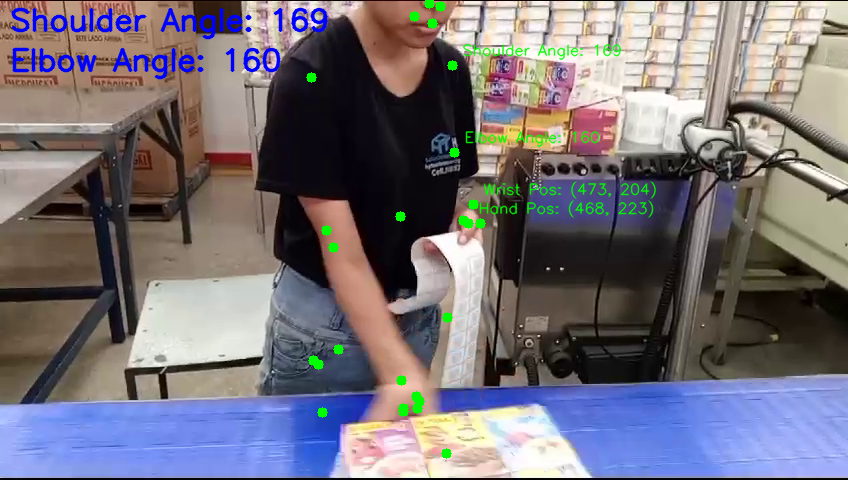

Frame 7:
  Shoulder Angle: 169.37948121224443
  Elbow Angle: 160.80018542571904
  Wrist Position: (0.5579550862312317, 0.4258626401424408, 0.04397148638963699)
  Hand Position: (0.5524091124534607, 0.46593040227890015, 0.03748858720064163)



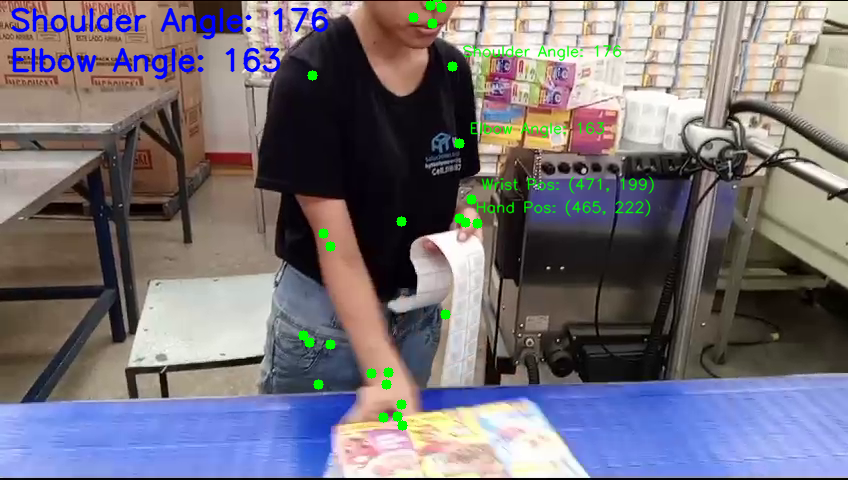

Frame 8:
  Shoulder Angle: 176.43545232353003
  Elbow Angle: 163.76673039048177
  Wrist Position: (0.5563353300094604, 0.4163596034049988, 0.04859865456819534)
  Hand Position: (0.5485241413116455, 0.4632183313369751, 0.03496791422367096)



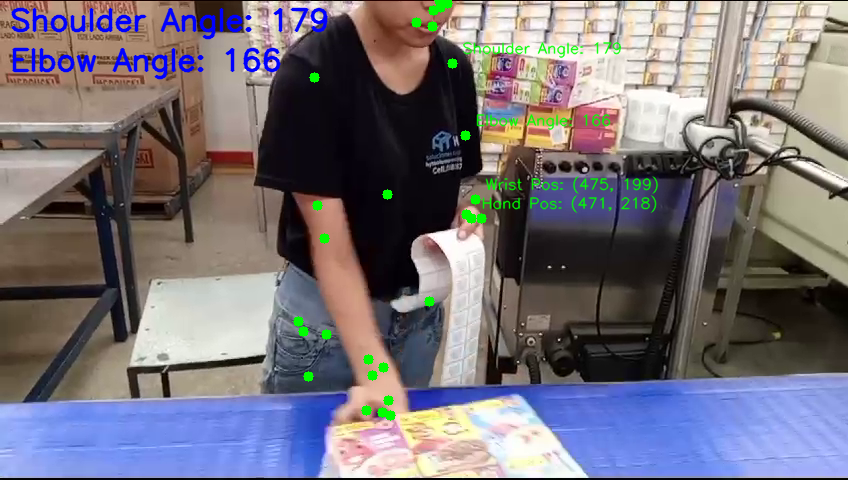

Frame 9:
  Shoulder Angle: 179.74844578436185
  Elbow Angle: 166.92056961016945
  Wrist Position: (0.5610690712928772, 0.4146159291267395, 0.03256147354841232)
  Hand Position: (0.5555712580680847, 0.45543771982192993, 0.014395010657608509)



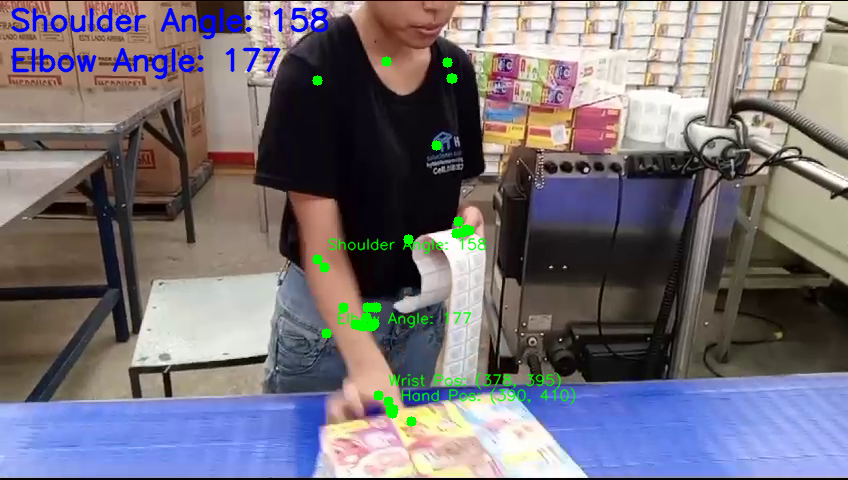

Frame 10:
  Shoulder Angle: 158.67232288369814
  Elbow Angle: 177.6222057320789
  Wrist Position: (0.44692617654800415, 0.8233804106712341, -0.15594756603240967)
  Hand Position: (0.4606967866420746, 0.8557597398757935, -0.17386282980442047)



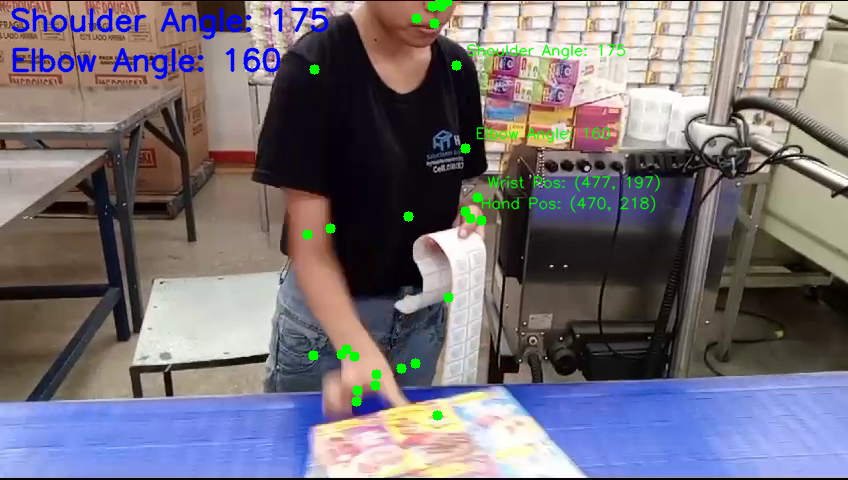

Frame 11:
  Shoulder Angle: 175.02842043046152
  Elbow Angle: 160.1687337595855
  Wrist Position: (0.5633402466773987, 0.41103512048721313, -0.10708708316087723)
  Hand Position: (0.5545516014099121, 0.45442408323287964, -0.12590065598487854)



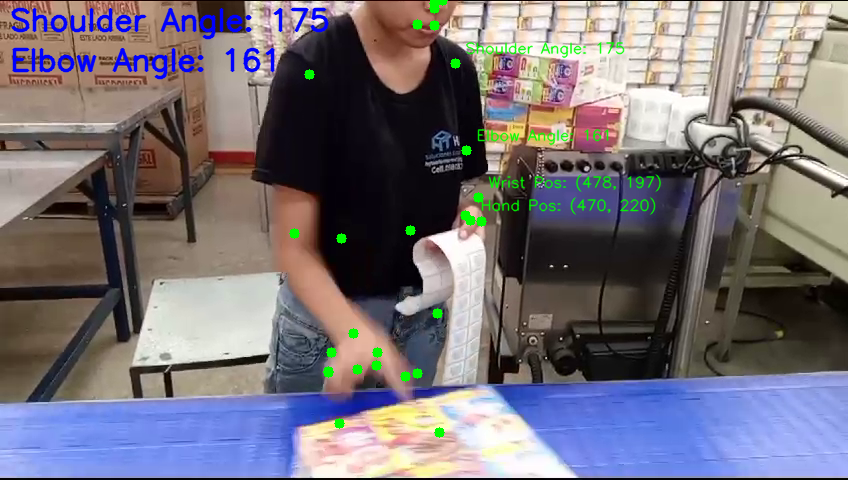

Frame 12:
  Shoulder Angle: 175.84980993323876
  Elbow Angle: 161.11178153170715
  Wrist Position: (0.5640120506286621, 0.4120364785194397, -0.06828539818525314)
  Hand Position: (0.5549154877662659, 0.45972955226898193, -0.0814429223537445)



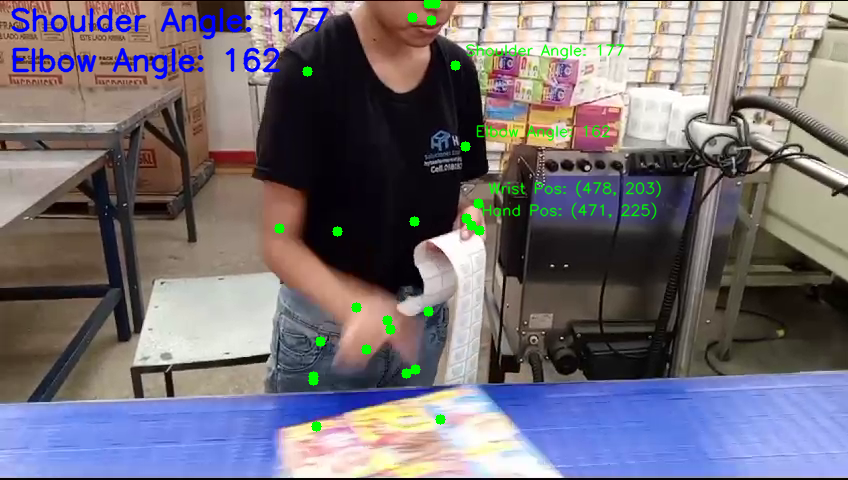

Frame 13:
  Shoulder Angle: 177.20405649177837
  Elbow Angle: 162.49287680500092
  Wrist Position: (0.5642352104187012, 0.42317062616348267, -0.05959365889430046)
  Hand Position: (0.5558276772499084, 0.4690874516963959, -0.08520875126123428)



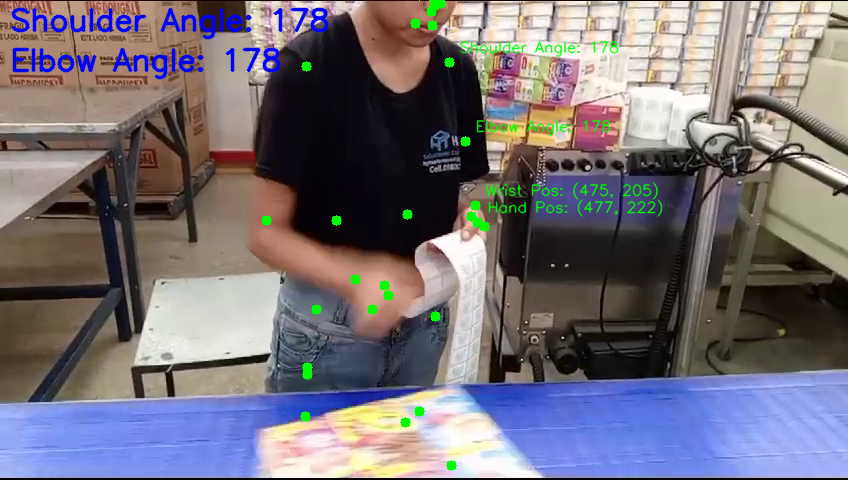

Frame 14:
  Shoulder Angle: 178.56285551167306
  Elbow Angle: 178.73485466145357
  Wrist Position: (0.5603165626525879, 0.4272836446762085, -0.06185013800859451)
  Hand Position: (0.5627150535583496, 0.4645110070705414, -0.08725999295711517)



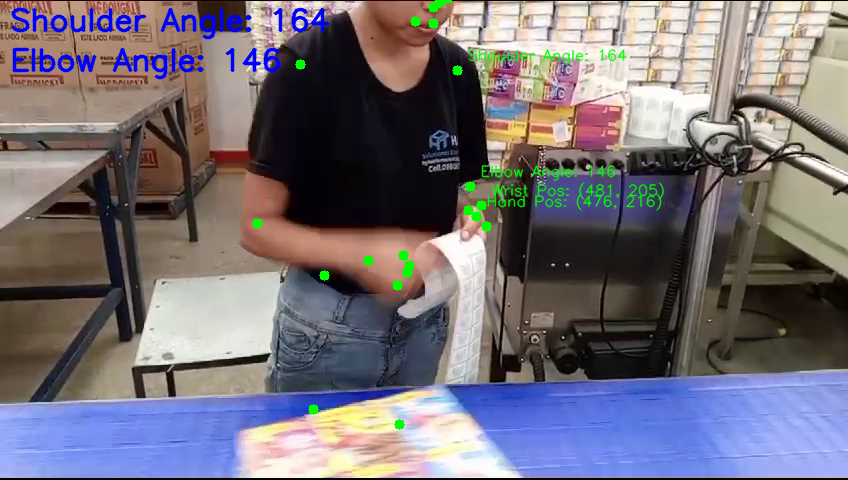

Frame 15:
  Shoulder Angle: 164.43530434908416
  Elbow Angle: 146.7345999171883
  Wrist Position: (0.5679678916931152, 0.42798563838005066, -0.7321738004684448)
  Hand Position: (0.5622774362564087, 0.4506935477256775, -0.8437160849571228)



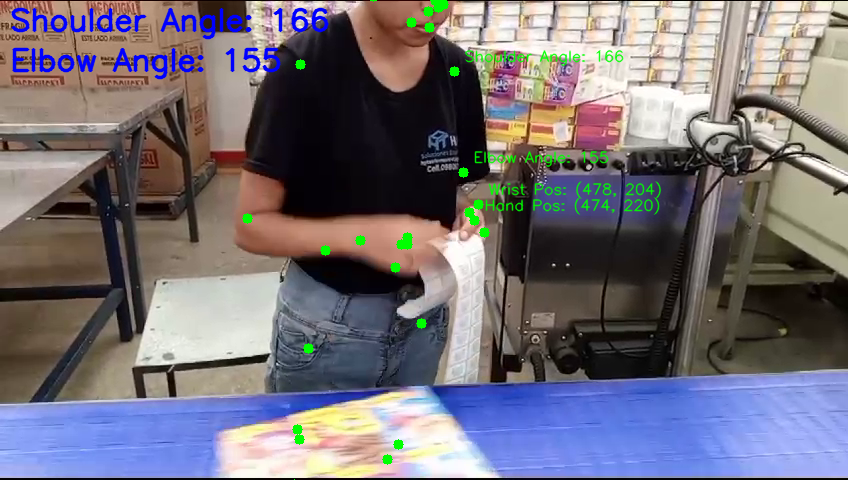

Frame 16:
  Shoulder Angle: 166.9352376094176
  Elbow Angle: 155.07703862106305
  Wrist Position: (0.5647422075271606, 0.4264683425426483, -0.8391233682632446)
  Hand Position: (0.5594335794448853, 0.45926210284233093, -0.9646867513656616)



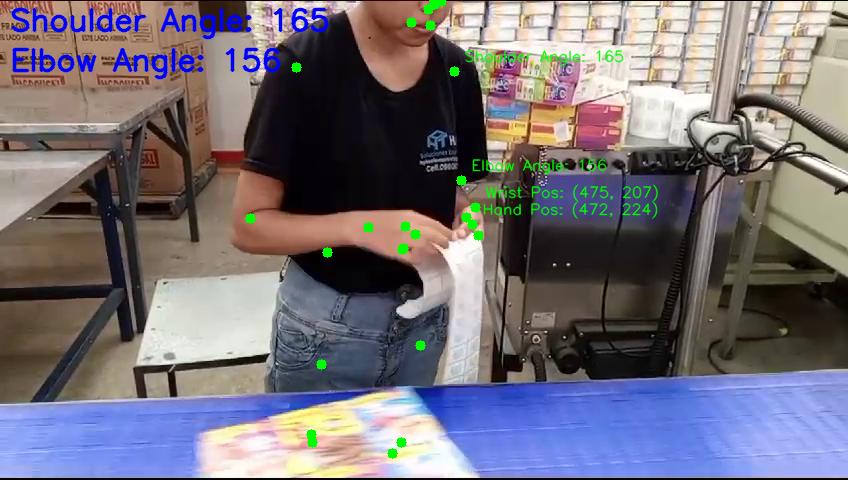

Frame 17:
  Shoulder Angle: 165.54784013261906
  Elbow Angle: 156.28849056536458
  Wrist Position: (0.5612301230430603, 0.4331660866737366, -0.8350867629051208)
  Hand Position: (0.5567276477813721, 0.46850281953811646, -0.9630692601203918)



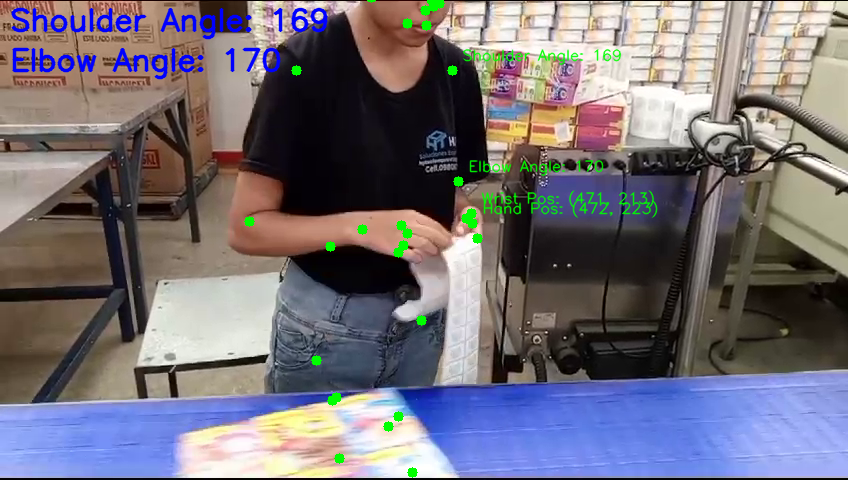

Frame 18:
  Shoulder Angle: 169.20907459988453
  Elbow Angle: 170.73355623908955
  Wrist Position: (0.5557276010513306, 0.445646733045578, -0.781120777130127)
  Hand Position: (0.5569214224815369, 0.46654167771339417, -0.8965210318565369)



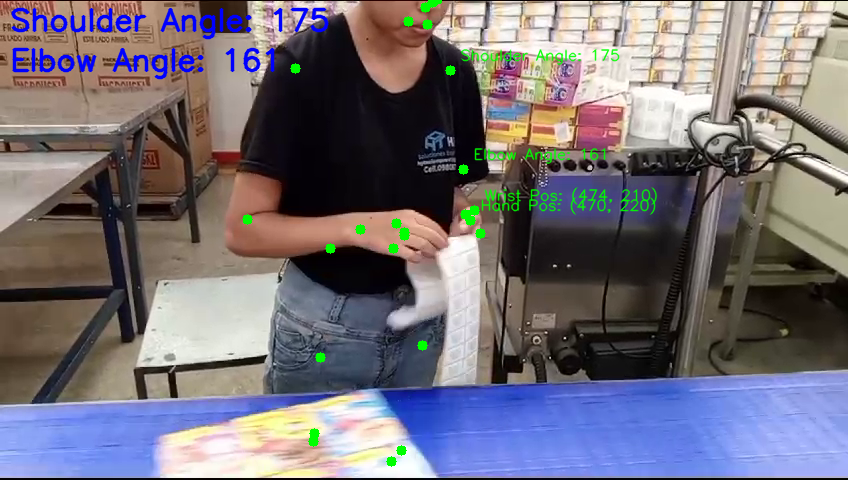

Frame 19:
  Shoulder Angle: 175.74242095365526
  Elbow Angle: 161.33434650682696
  Wrist Position: (0.5592638254165649, 0.4378373324871063, -0.726588785648346)
  Hand Position: (0.55531245470047, 0.46014395356178284, -0.842337429523468)



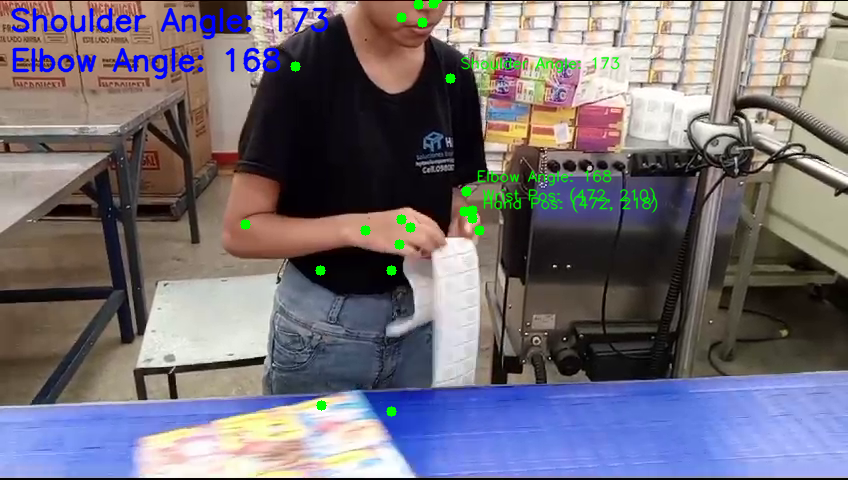

Frame 20:
  Shoulder Angle: 173.68851099302046
  Elbow Angle: 168.48589185046075
  Wrist Position: (0.557506263256073, 0.4387819170951843, -0.58013916015625)
  Hand Position: (0.5573539733886719, 0.4543505609035492, -0.6802760362625122)



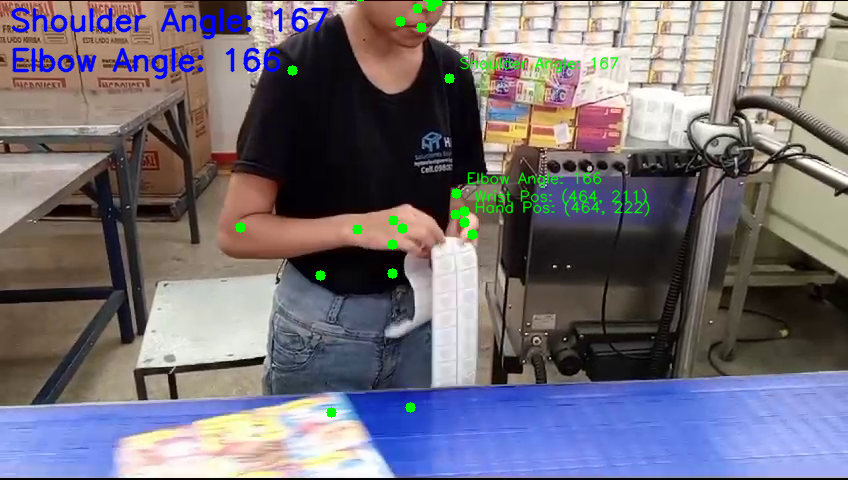

Frame 21:
  Shoulder Angle: 167.9193460758915
  Elbow Angle: 166.5634248276033
  Wrist Position: (0.5475573539733887, 0.43961578607559204, -0.7029393315315247)
  Hand Position: (0.5478267669677734, 0.4626595079898834, -0.8267222046852112)



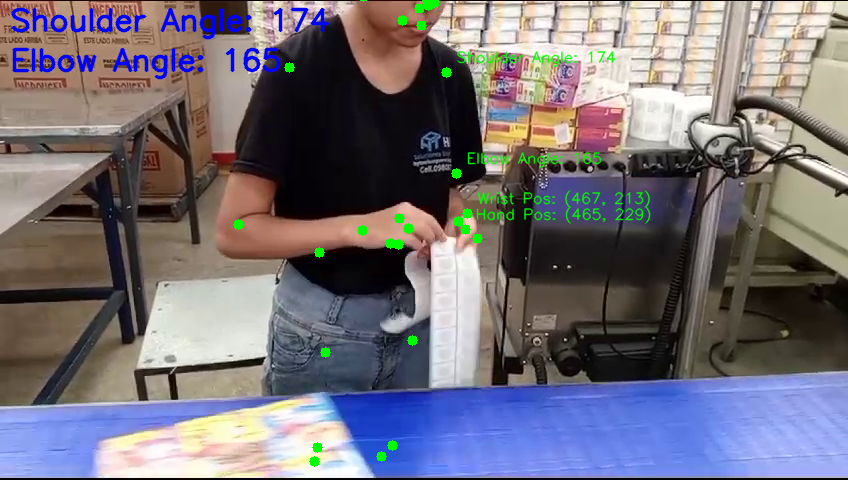

Frame 22:
  Shoulder Angle: 174.2287739280095
  Elbow Angle: 165.267593046206
  Wrist Position: (0.5518679618835449, 0.4451290965080261, -0.708246648311615)
  Hand Position: (0.5485324263572693, 0.4785116910934448, -0.8344692587852478)



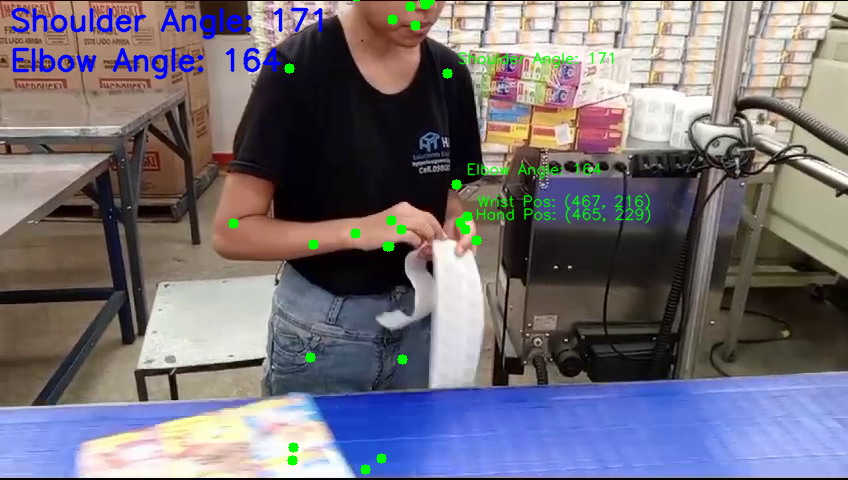

Frame 23:
  Shoulder Angle: 171.51456619044959
  Elbow Angle: 164.5882904735829
  Wrist Position: (0.55106520652771, 0.4507957696914673, -0.7163639664649963)
  Hand Position: (0.5490089058876038, 0.4775908589363098, -0.8341666460037231)



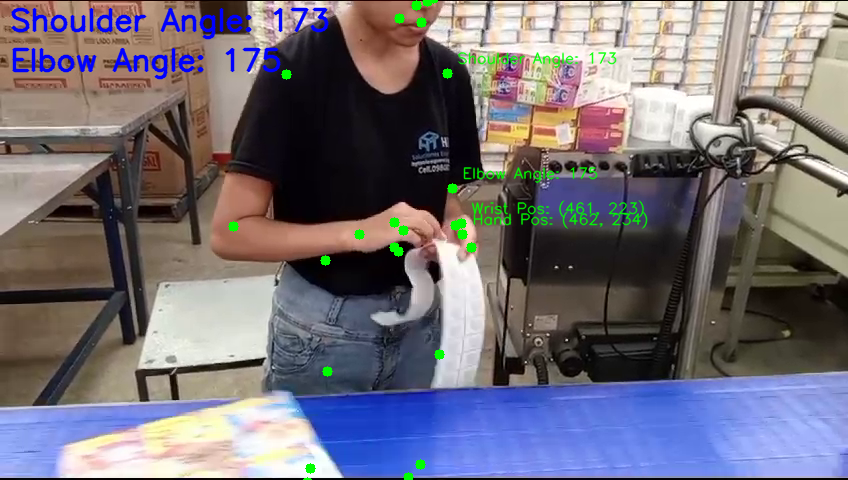

Frame 24:
  Shoulder Angle: 173.12502647920692
  Elbow Angle: 175.766698617914
  Wrist Position: (0.5441878437995911, 0.4658326208591461, -0.7325981259346008)
  Hand Position: (0.5457363724708557, 0.48825323581695557, -0.8546953201293945)



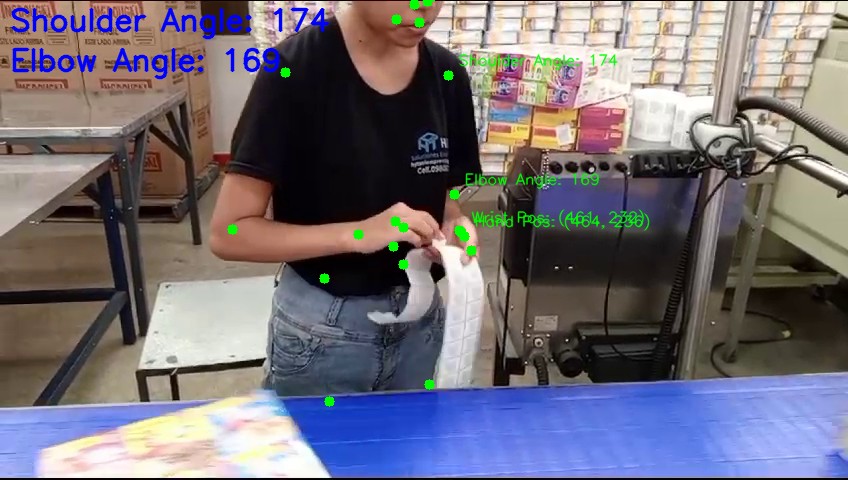

Frame 25:
  Shoulder Angle: 174.8792376239068
  Elbow Angle: 169.44919564873766
  Wrist Position: (0.5447823405265808, 0.4841875731945038, -0.6801767349243164)
  Hand Position: (0.5476983785629272, 0.49360519647598267, -0.7962082624435425)



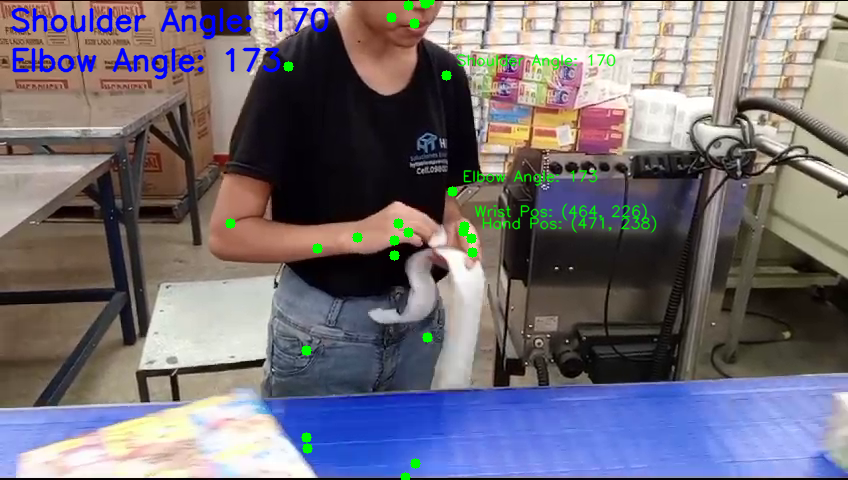

Frame 26:
  Shoulder Angle: 170.62105396017628
  Elbow Angle: 173.2163734022375
  Wrist Position: (0.5478406548500061, 0.4725274443626404, -0.663780689239502)
  Hand Position: (0.555721640586853, 0.4972016215324402, -0.7627236843109131)



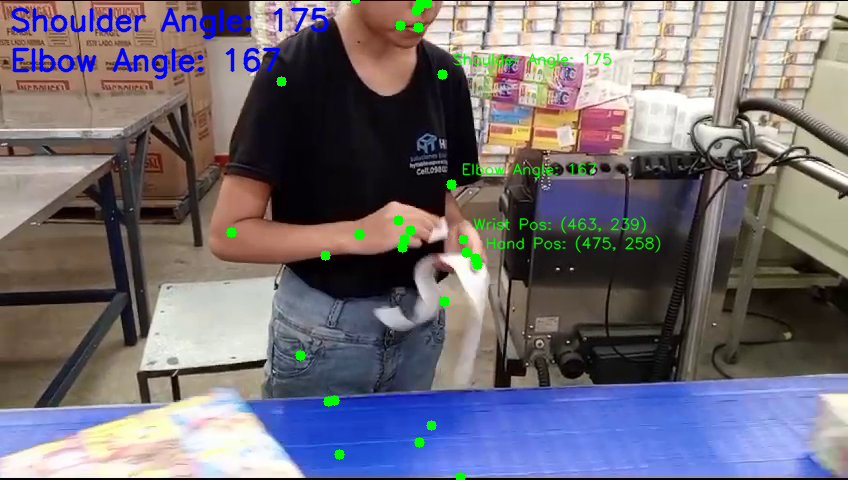

Frame 27:
  Shoulder Angle: 175.63974810304188
  Elbow Angle: 167.41967599416745
  Wrist Position: (0.5460599660873413, 0.49821484088897705, -0.5863465070724487)
  Hand Position: (0.5603095293045044, 0.5383649468421936, -0.6849238276481628)



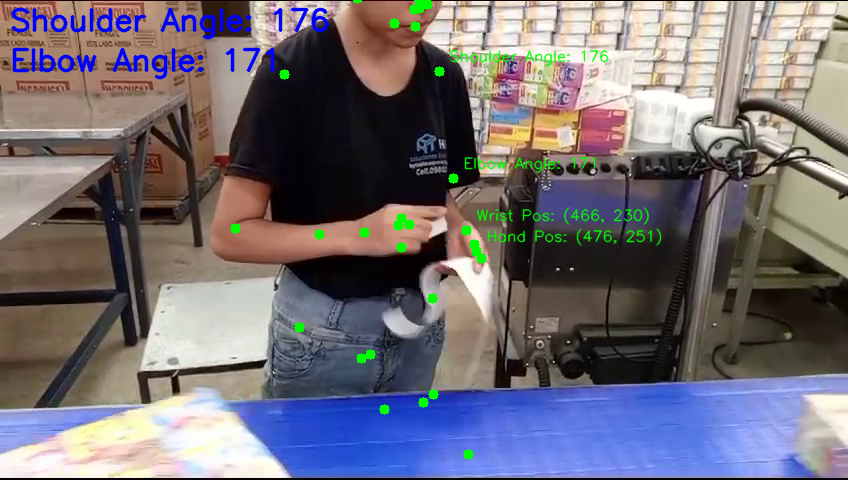

Frame 28:
  Shoulder Angle: 176.4222566037832
  Elbow Angle: 171.8147879911336
  Wrist Position: (0.5497357249259949, 0.481161504983902, -0.5438204407691956)
  Hand Position: (0.5619075298309326, 0.5238247513771057, -0.6288062334060669)



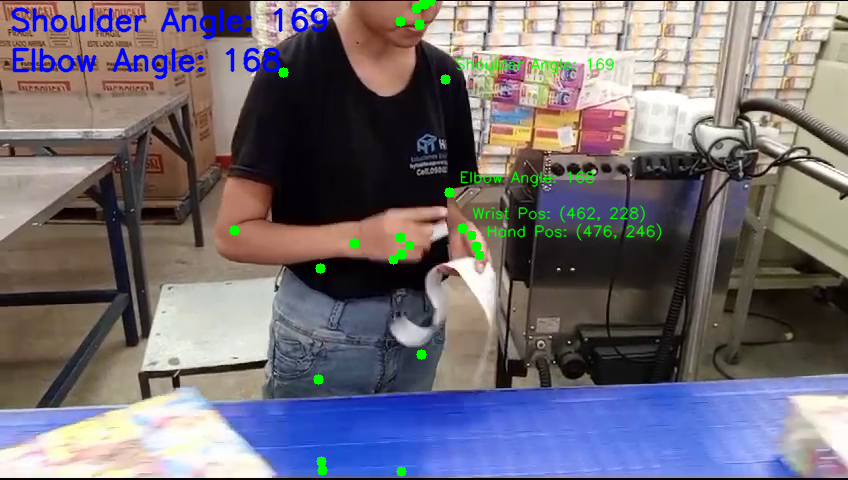

Frame 29:
  Shoulder Angle: 169.8730808109477
  Elbow Angle: 168.65239409149697
  Wrist Position: (0.5457687973976135, 0.475193589925766, -0.8252829909324646)
  Hand Position: (0.5622694492340088, 0.5142986178398132, -0.9459862112998962)



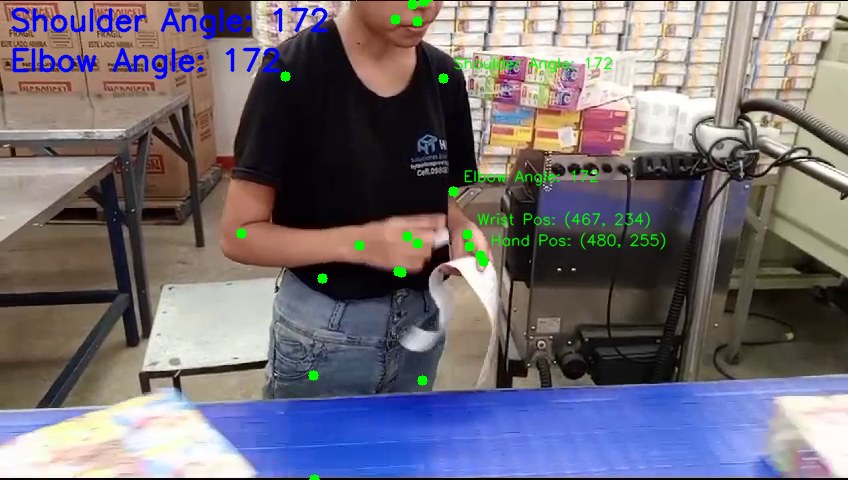

Frame 30:
  Shoulder Angle: 172.2547596617279
  Elbow Angle: 172.0111365219928
  Wrist Position: (0.5512118935585022, 0.4879210889339447, -0.6680137515068054)
  Hand Position: (0.5661473870277405, 0.5321633219718933, -0.7792360782623291)



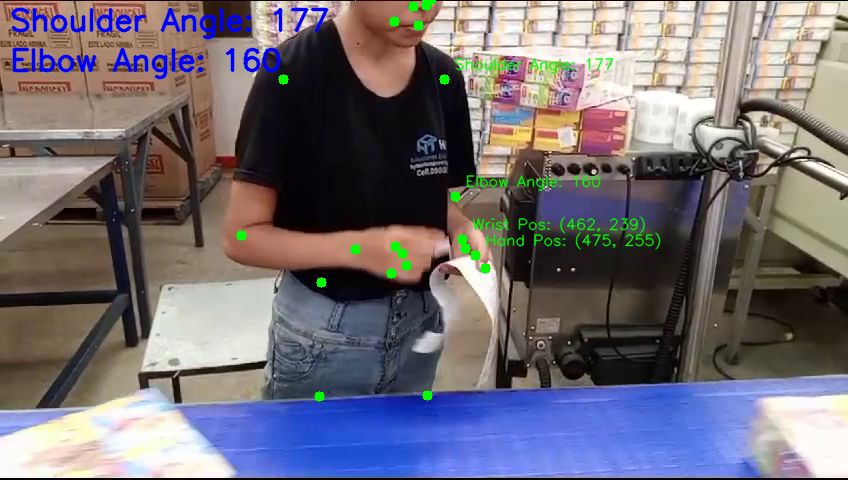

Frame 31:
  Shoulder Angle: 177.06210803649915
  Elbow Angle: 160.9677534544824
  Wrist Position: (0.5459588766098022, 0.49925994873046875, -0.7870000004768372)
  Hand Position: (0.5608115792274475, 0.5312926173210144, -0.9213339686393738)



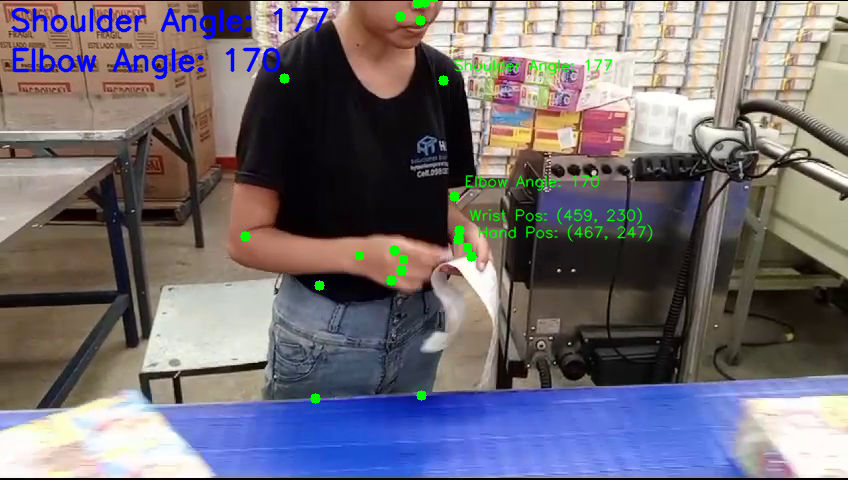

Frame 32:
  Shoulder Angle: 177.91536282156812
  Elbow Angle: 170.48762852499016
  Wrist Position: (0.5424219965934753, 0.4803621172904968, -0.6707094311714172)
  Hand Position: (0.5513997077941895, 0.514819860458374, -0.7919350862503052)



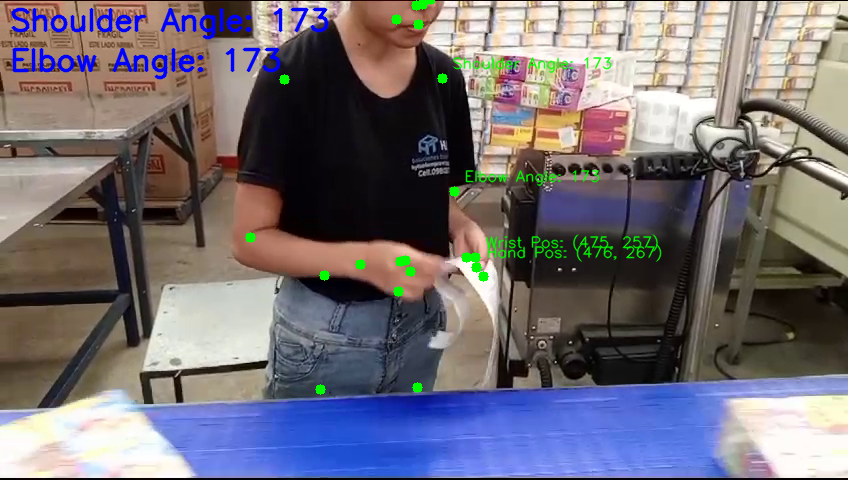

Frame 33:
  Shoulder Angle: 173.16946775130674
  Elbow Angle: 173.77009841258896
  Wrist Position: (0.5605819225311279, 0.5367772579193115, -0.7254558801651001)
  Hand Position: (0.5619147419929504, 0.5563398003578186, -0.8520756363868713)



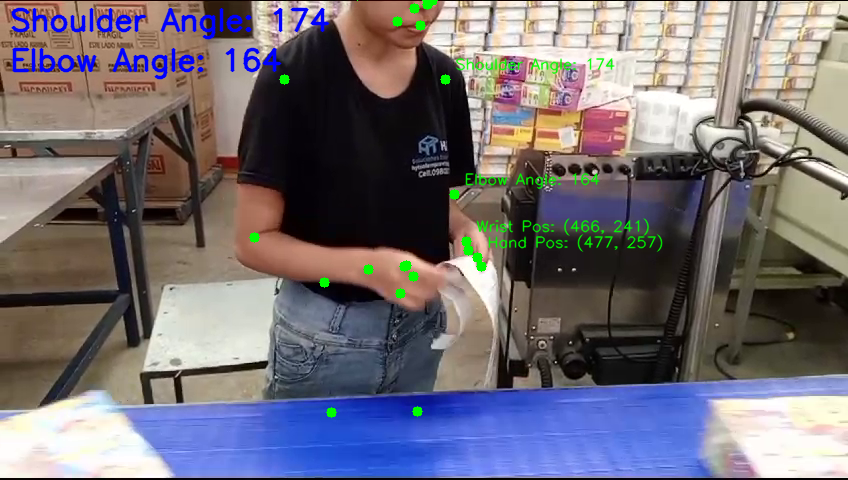

Frame 34:
  Shoulder Angle: 174.8525056572203
  Elbow Angle: 164.91027669796136
  Wrist Position: (0.5498754382133484, 0.504044771194458, -0.7376704216003418)
  Hand Position: (0.5632483959197998, 0.5357547402381897, -0.8571951985359192)



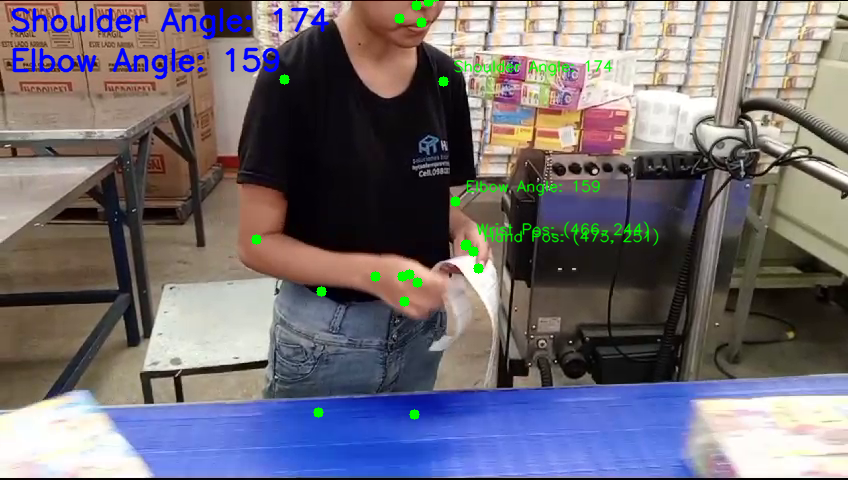

Frame 35:
  Shoulder Angle: 174.51108661415495
  Elbow Angle: 159.34168336950682
  Wrist Position: (0.5501285195350647, 0.5085529088973999, -0.6705079674720764)
  Hand Position: (0.5584957599639893, 0.5235234498977661, -0.7835238575935364)



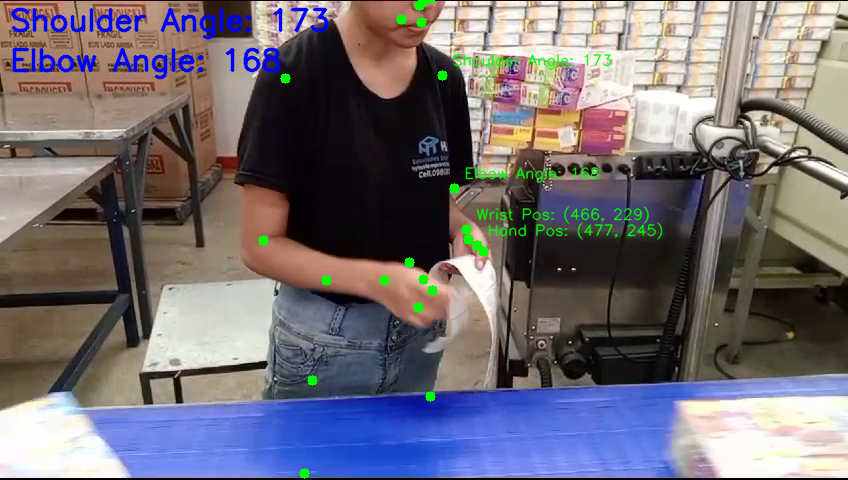

Frame 36:
  Shoulder Angle: 173.50941651442733
  Elbow Angle: 168.00967128232412
  Wrist Position: (0.5505343675613403, 0.4789101481437683, -0.8930326700210571)
  Hand Position: (0.5635520219802856, 0.5115601420402527, -1.010054588317871)



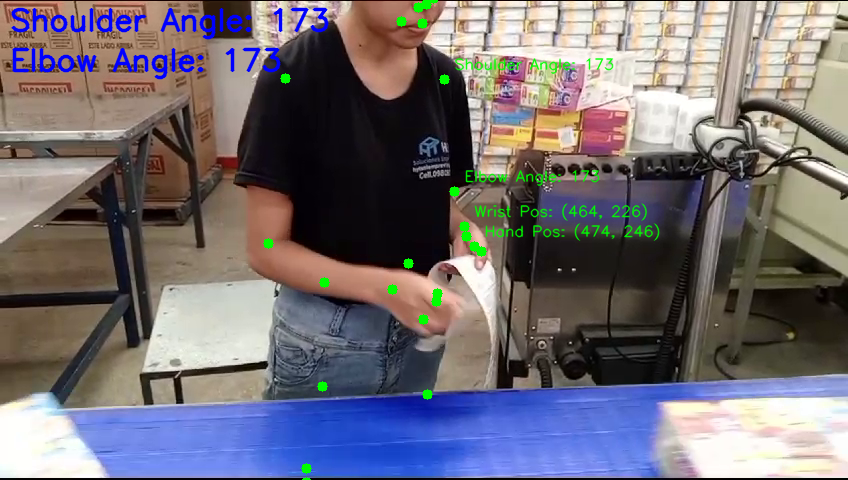

Frame 37:
  Shoulder Angle: 173.65464969137247
  Elbow Angle: 173.6756727302643
  Wrist Position: (0.5477017760276794, 0.47168177366256714, -0.793175458908081)
  Hand Position: (0.5590914487838745, 0.5128331184387207, -0.9014812707901001)



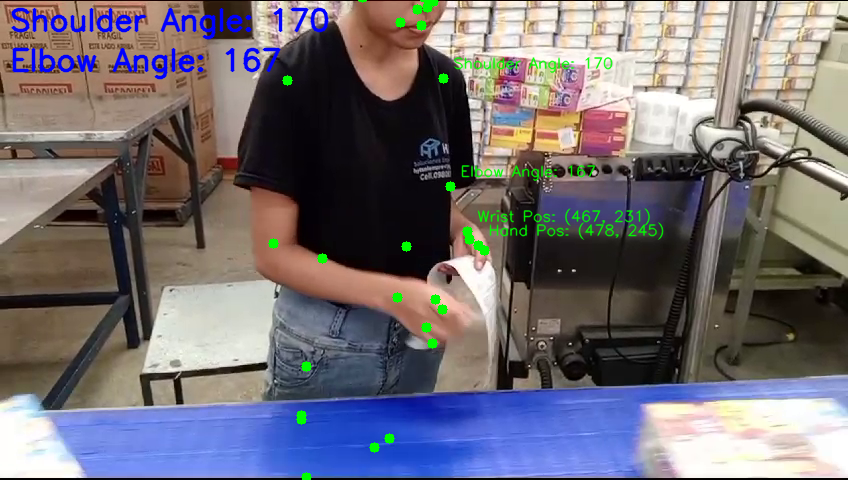

Frame 38:
  Shoulder Angle: 170.8087036899422
  Elbow Angle: 167.10500311796298
  Wrist Position: (0.5508192181587219, 0.48181667923927307, -1.004104733467102)
  Hand Position: (0.5639401078224182, 0.5107423663139343, -1.1136196851730347)



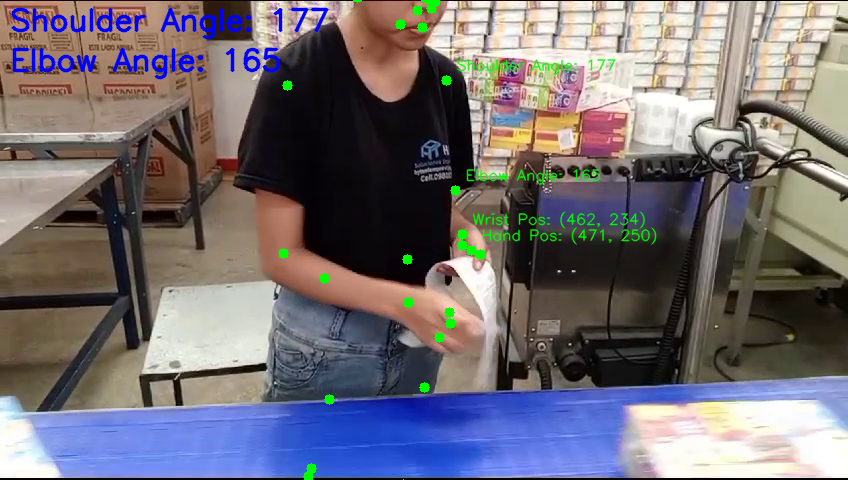

Frame 39:
  Shoulder Angle: 177.74294128024502
  Elbow Angle: 165.54195195666256
  Wrist Position: (0.5452643632888794, 0.48886483907699585, -0.832266092300415)
  Hand Position: (0.5565539002418518, 0.5208609104156494, -0.9356213212013245)



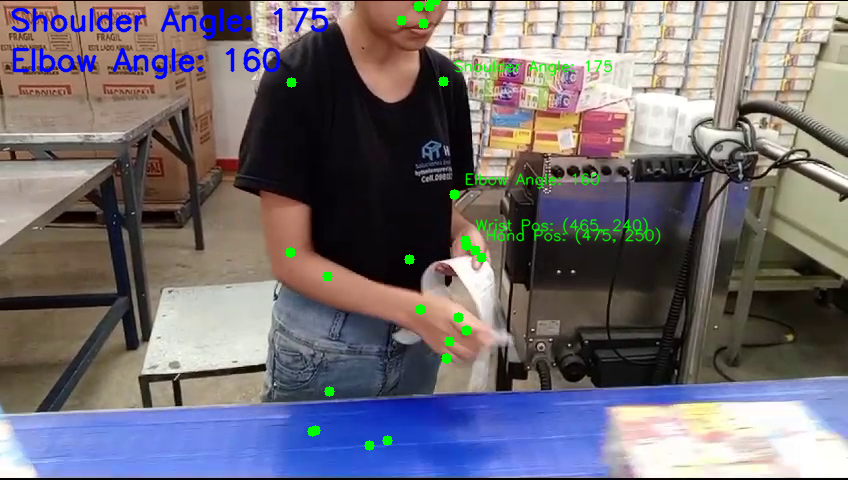

Frame 40:
  Shoulder Angle: 175.62649898850867
  Elbow Angle: 160.2089839524123
  Wrist Position: (0.5490319728851318, 0.5007196664810181, -0.9306725263595581)
  Hand Position: (0.5604636073112488, 0.5228015184402466, -1.035576581954956)



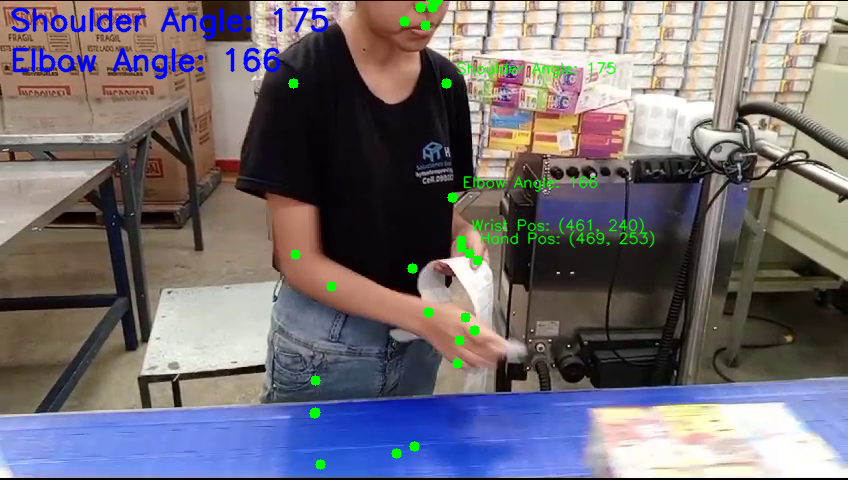

Frame 41:
  Shoulder Angle: 175.03933906079462
  Elbow Angle: 166.68970013429967
  Wrist Position: (0.5445073246955872, 0.5011042356491089, -0.8141369819641113)
  Hand Position: (0.5542352795600891, 0.5276088118553162, -0.9210415482521057)



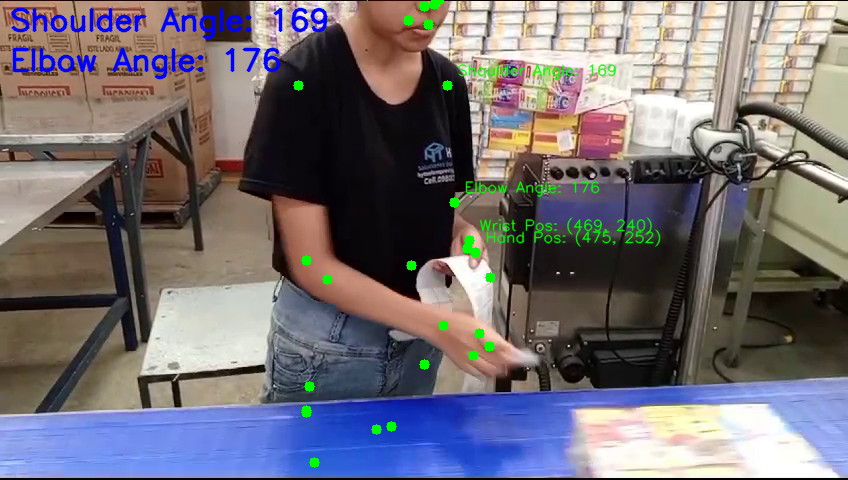

Frame 42:
  Shoulder Angle: 169.1549269555936
  Elbow Angle: 176.78981324666057
  Wrist Position: (0.5534705519676208, 0.5011526942253113, -0.8124520182609558)
  Hand Position: (0.5604956150054932, 0.5259410738945007, -0.9096659421920776)



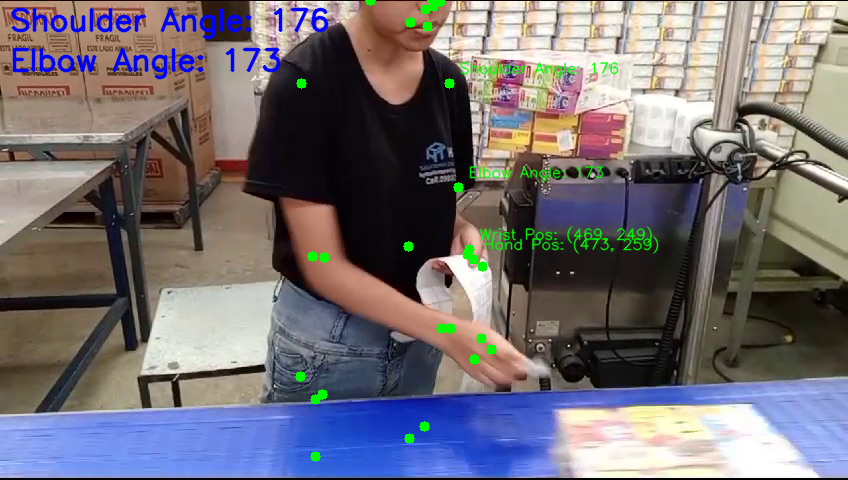

Frame 43:
  Shoulder Angle: 176.87409172669032
  Elbow Angle: 173.50562212403318
  Wrist Position: (0.554031491279602, 0.519128680229187, -0.8786519765853882)
  Hand Position: (0.5586603283882141, 0.5400264263153076, -0.9715584516525269)



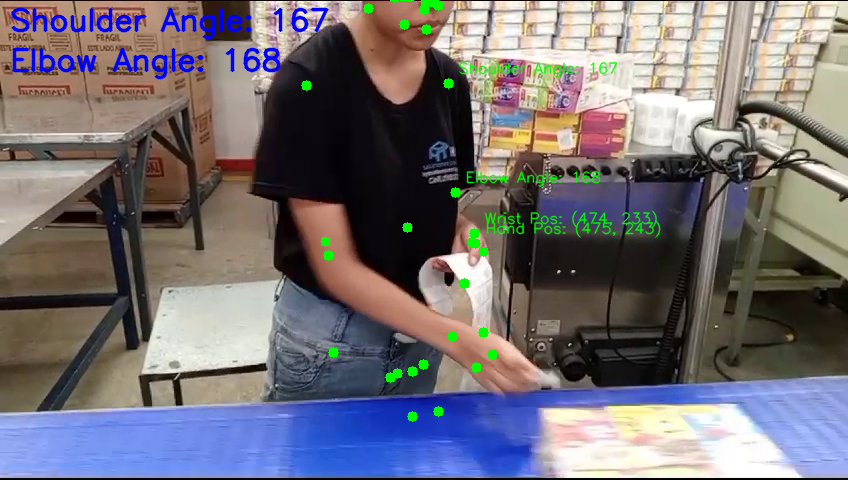

Frame 44:
  Shoulder Angle: 167.47919291538662
  Elbow Angle: 168.6335194106491
  Wrist Position: (0.5594854354858398, 0.48613661527633667, -0.7539231777191162)
  Hand Position: (0.560684084892273, 0.5065550208091736, -0.8346582651138306)



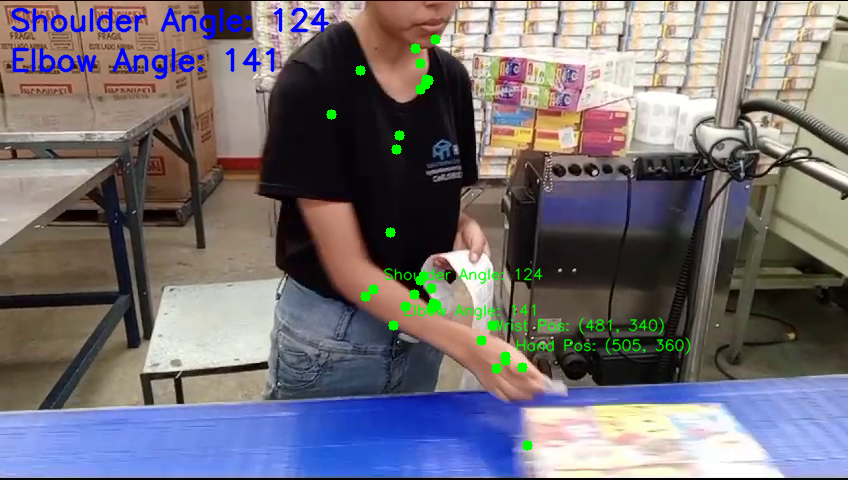

Frame 45:
  Shoulder Angle: 124.46765206217005
  Elbow Angle: 141.59934556222836
  Wrist Position: (0.5679425001144409, 0.7093311548233032, -0.22048313915729523)
  Hand Position: (0.5962941646575928, 0.7502752542495728, -0.23528431355953217)



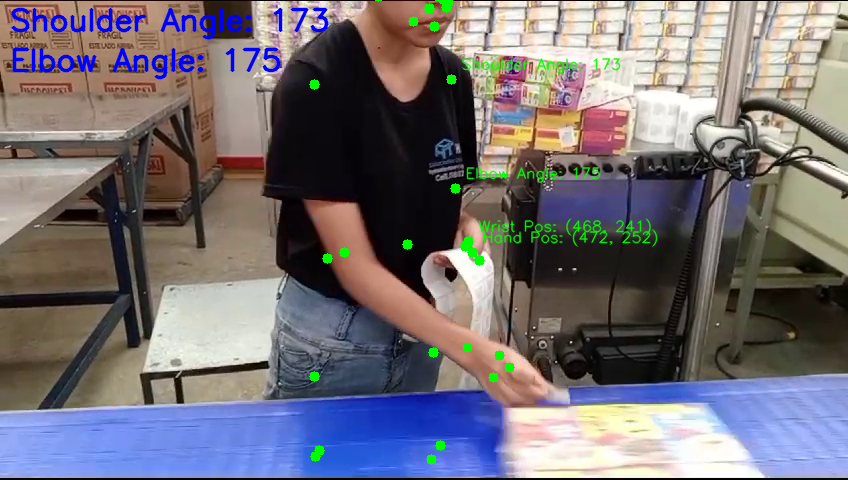

Frame 46:
  Shoulder Angle: 173.12444630555325
  Elbow Angle: 175.80049284932542
  Wrist Position: (0.5520315170288086, 0.5030299425125122, -0.5969163775444031)
  Hand Position: (0.5567465424537659, 0.5251258611679077, -0.6677354574203491)



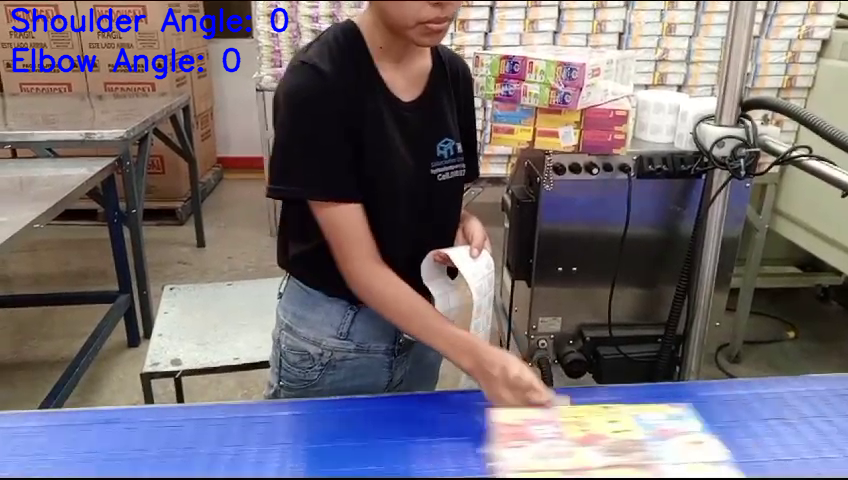

Frame 47:
  Shoulder Angle: None
  Elbow Angle: None
  Wrist Position: None
  Hand Position: None



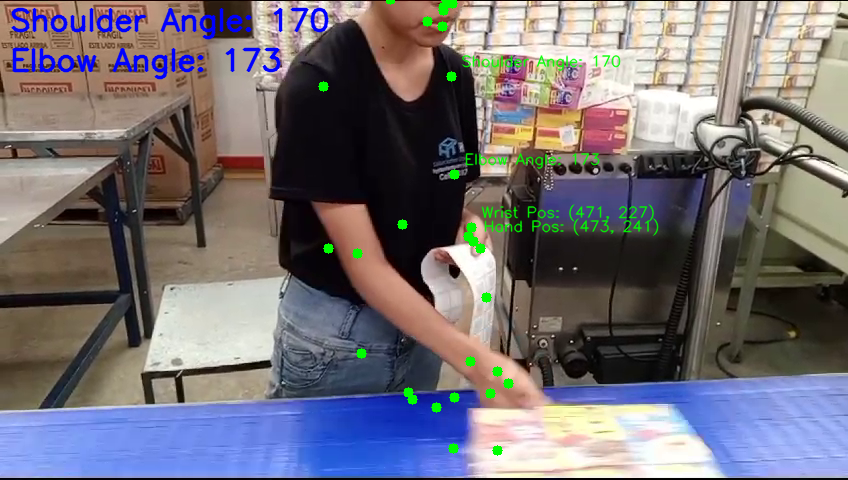

Frame 48:
  Shoulder Angle: 170.8937634962033
  Elbow Angle: 173.8982164917242
  Wrist Position: (0.5558862090110779, 0.47426754236221313, -0.34081634879112244)
  Hand Position: (0.5579180717468262, 0.5036584734916687, -0.4005495607852936)



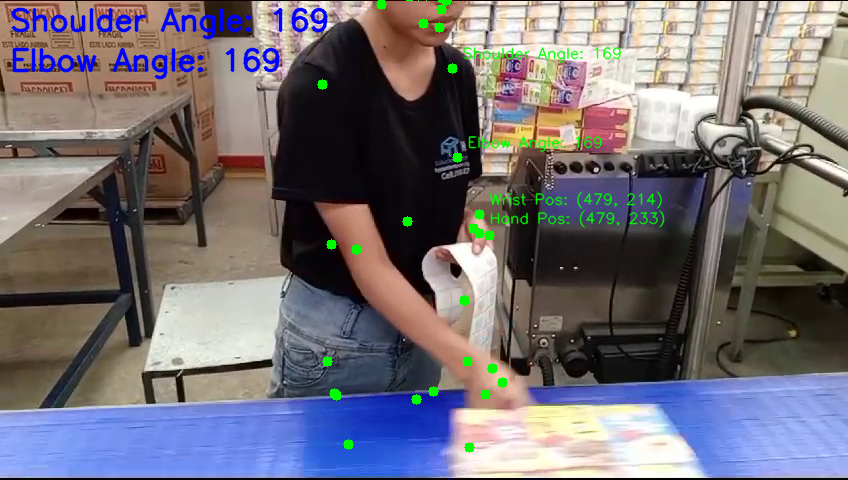

Frame 49:
  Shoulder Angle: 169.57957111378278
  Elbow Angle: 169.4572615304696
  Wrist Position: (0.5648667812347412, 0.44617217779159546, -0.2928355038166046)
  Hand Position: (0.5660079717636108, 0.4866083264350891, -0.35675472021102905)



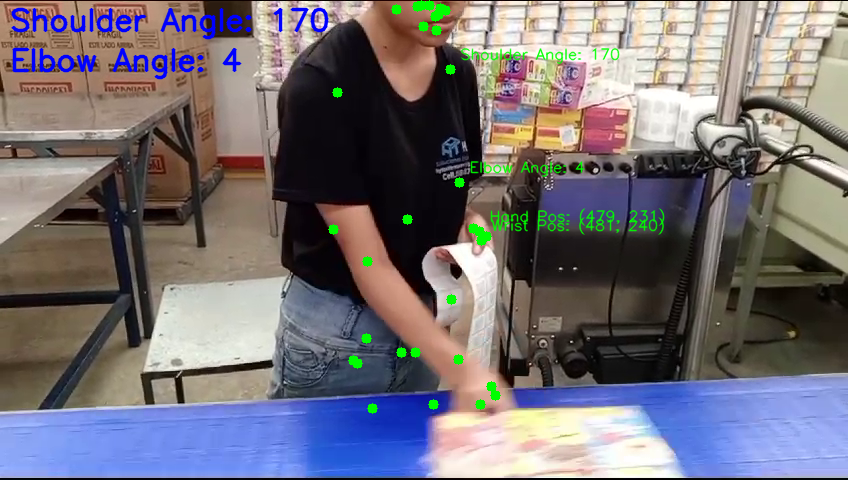

Frame 50:
  Shoulder Angle: 170.83073204594717
  Elbow Angle: 4.427393544228428
  Wrist Position: (0.567394495010376, 0.5006375312805176, -0.48756328225135803)
  Hand Position: (0.5650155544281006, 0.4825117886066437, -0.541685163974762)



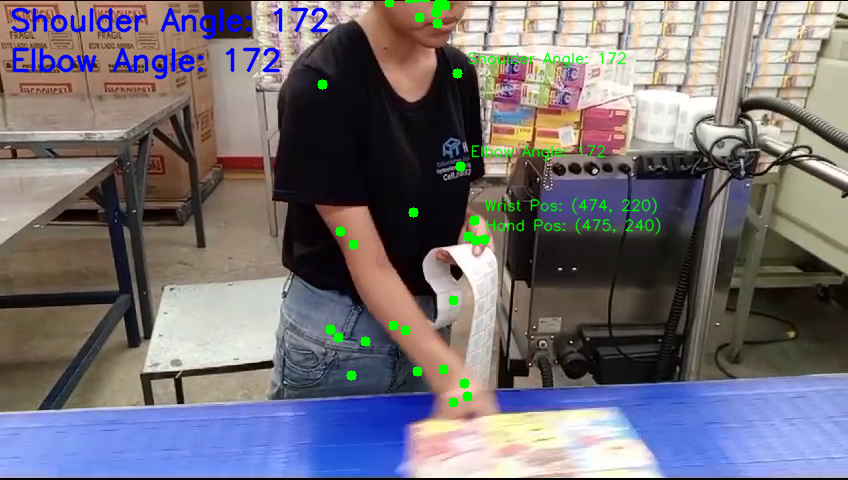

Frame 51:
  Shoulder Angle: 172.94845230288402
  Elbow Angle: 172.7125872932529
  Wrist Position: (0.5597549080848694, 0.4590153098106384, -0.12477679550647736)
  Hand Position: (0.5605003237724304, 0.500490128993988, -0.14859439432621002)



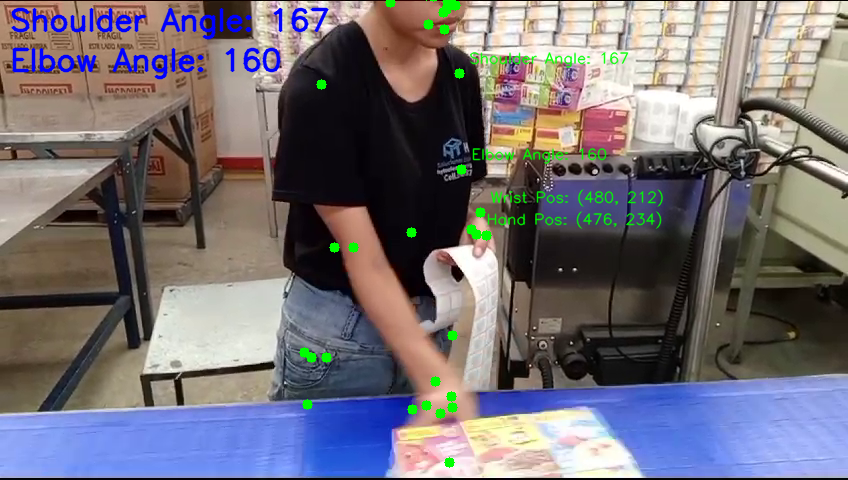

Frame 52:
  Shoulder Angle: 167.0158181665714
  Elbow Angle: 160.51505108614646
  Wrist Position: (0.5664685368537903, 0.4436300992965698, 0.005992111749947071)
  Hand Position: (0.561774730682373, 0.48878711462020874, -0.005627078469842672)



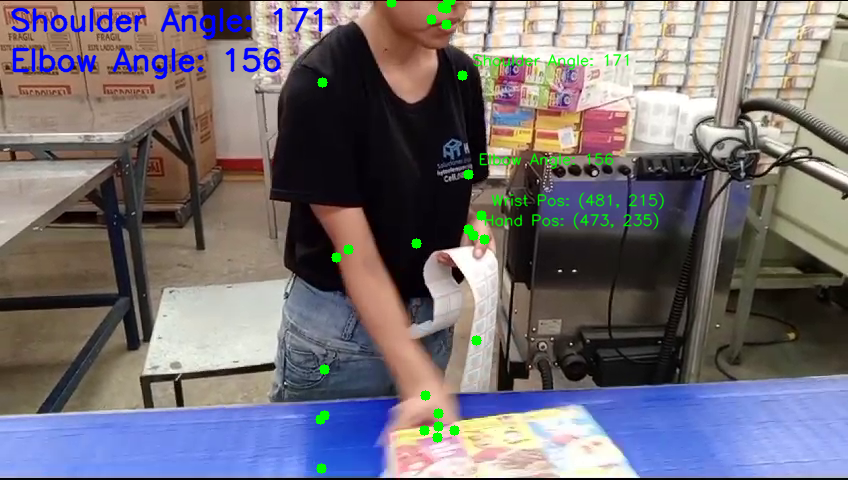

Frame 53:
  Shoulder Angle: 171.20185903361704
  Elbow Angle: 156.68744923010857
  Wrist Position: (0.568253755569458, 0.4481652081012726, -0.058950215578079224)
  Hand Position: (0.5586953163146973, 0.4907654821872711, -0.07136702537536621)



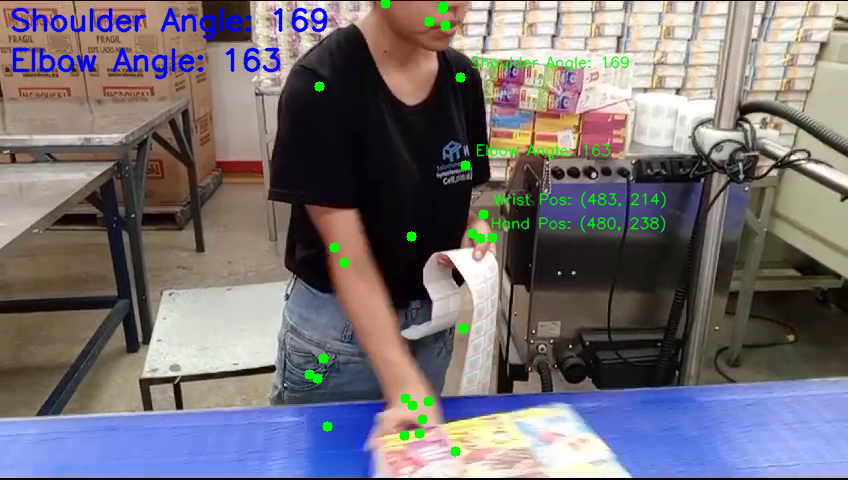

Frame 54:
  Shoulder Angle: 169.59891769691524
  Elbow Angle: 163.75227551889014
  Wrist Position: (0.569969654083252, 0.4472581446170807, 0.10752403736114502)
  Hand Position: (0.566312849521637, 0.49625012278556824, 0.10070115327835083)



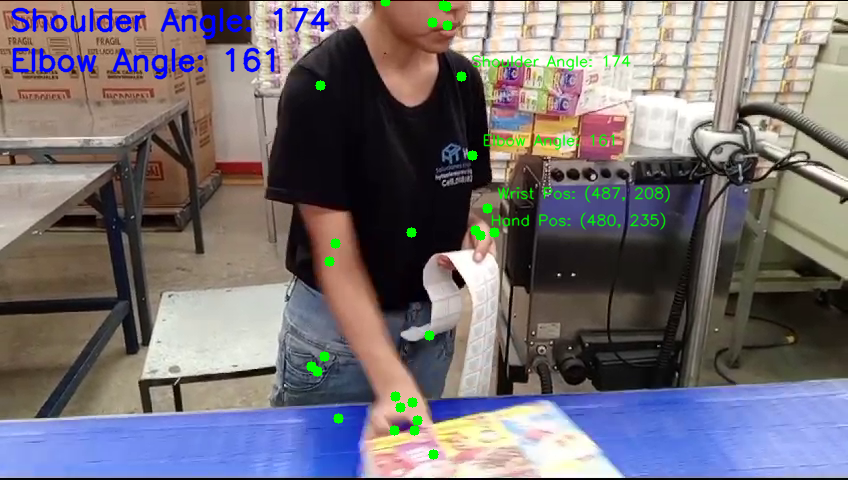

Frame 55:
  Shoulder Angle: 174.80241256995382
  Elbow Angle: 161.34596731490626
  Wrist Position: (0.5753862261772156, 0.4342251420021057, 0.04279959574341774)
  Hand Position: (0.5664836168289185, 0.49026310443878174, 0.02642376720905304)



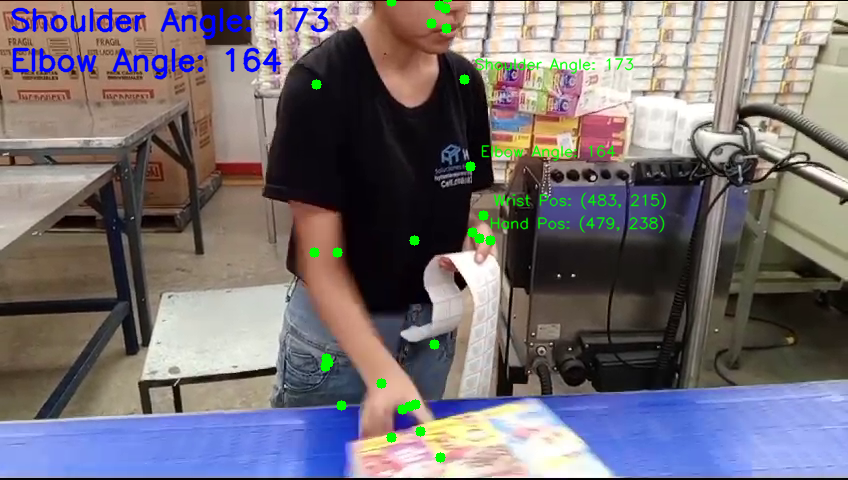

Frame 56:
  Shoulder Angle: 173.49298711567204
  Elbow Angle: 164.7708004962765
  Wrist Position: (0.5704290866851807, 0.44900253415107727, -0.048020292073488235)
  Hand Position: (0.5649855732917786, 0.4969954490661621, -0.06613632291555405)



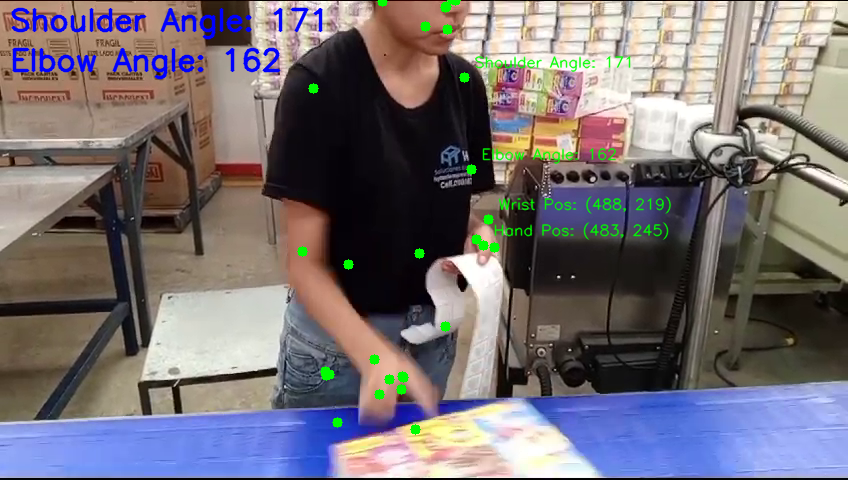

Frame 57:
  Shoulder Angle: 171.85244682560216
  Elbow Angle: 162.24544775792774
  Wrist Position: (0.5762407779693604, 0.4572826623916626, -0.10132381319999695)
  Hand Position: (0.5696152448654175, 0.510932207107544, -0.14058084785938263)



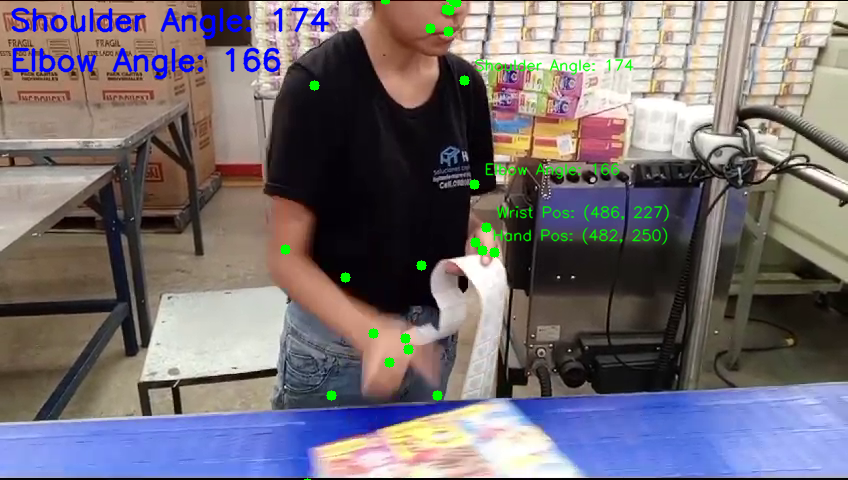

Frame 58:
  Shoulder Angle: 174.31424450380746
  Elbow Angle: 166.3237568424412
  Wrist Position: (0.5734666585922241, 0.4729638397693634, -0.5454061627388)
  Hand Position: (0.5694317817687988, 0.5212045311927795, -0.6442192196846008)



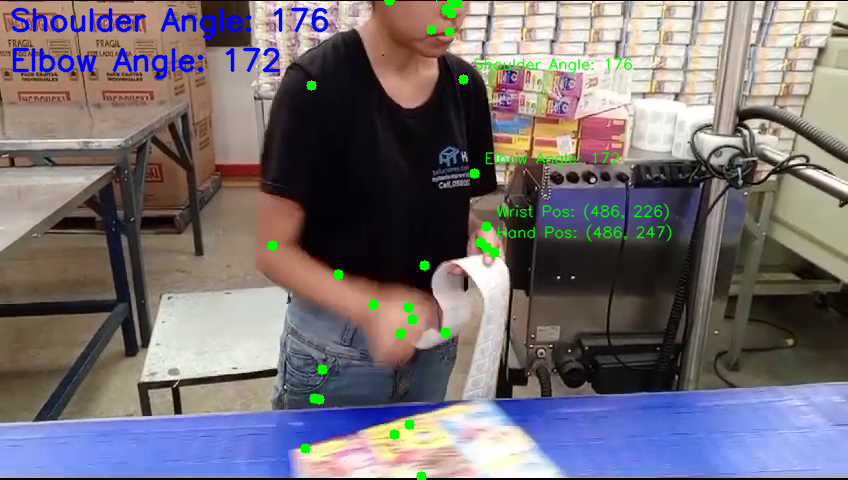

Frame 59:
  Shoulder Angle: 176.40993984240595
  Elbow Angle: 172.74057022036519
  Wrist Position: (0.5733593702316284, 0.47161775827407837, -0.27756595611572266)
  Hand Position: (0.5733838677406311, 0.5166407823562622, -0.356645792722702)



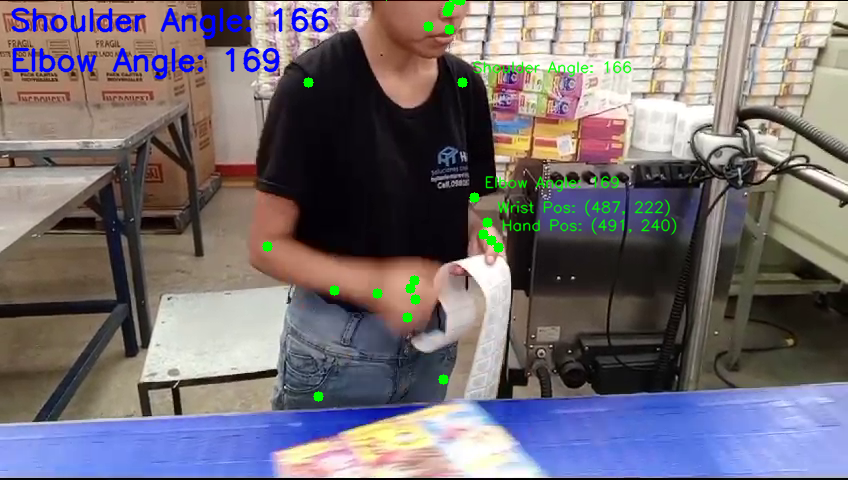

Frame 60:
  Shoulder Angle: 166.74082986710914
  Elbow Angle: 169.09088442862998
  Wrist Position: (0.5751219987869263, 0.4628358483314514, -0.7410830855369568)
  Hand Position: (0.5790347456932068, 0.5016723871231079, -0.8673675060272217)



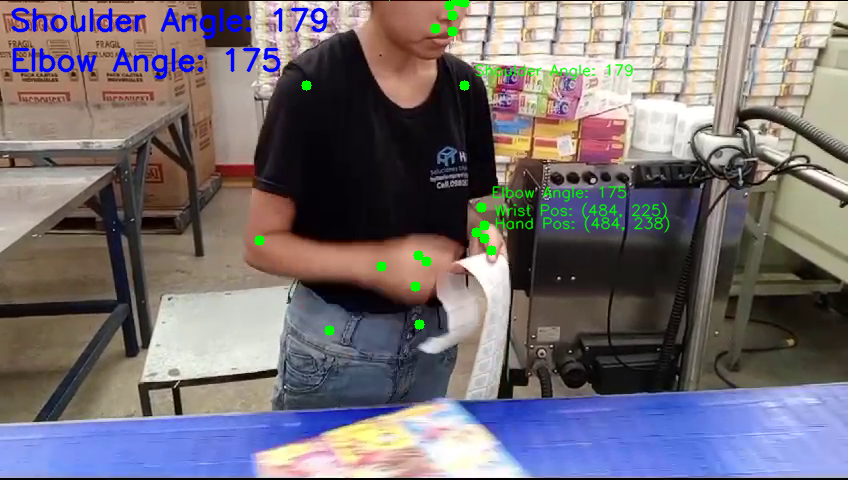

Frame 61:
  Shoulder Angle: 179.47929890760702
  Elbow Angle: 175.6693390806391
  Wrist Position: (0.5708593130111694, 0.46900755167007446, -0.36210569739341736)
  Hand Position: (0.5711715221405029, 0.49749046564102173, -0.4470134377479553)



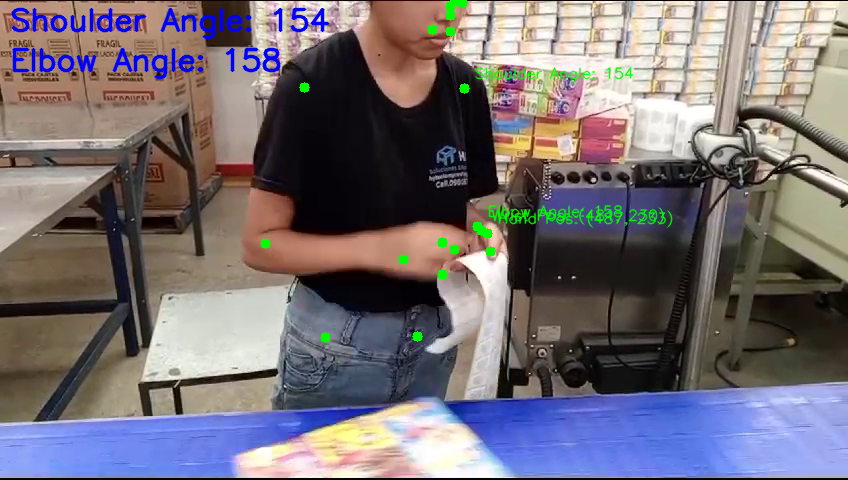

Frame 62:
  Shoulder Angle: 154.68676271232815
  Elbow Angle: 158.5615795724357
  Wrist Position: (0.5672585368156433, 0.4802829921245575, -0.32366156578063965)
  Hand Position: (0.5751200914382935, 0.4869479835033417, -0.3938431739807129)



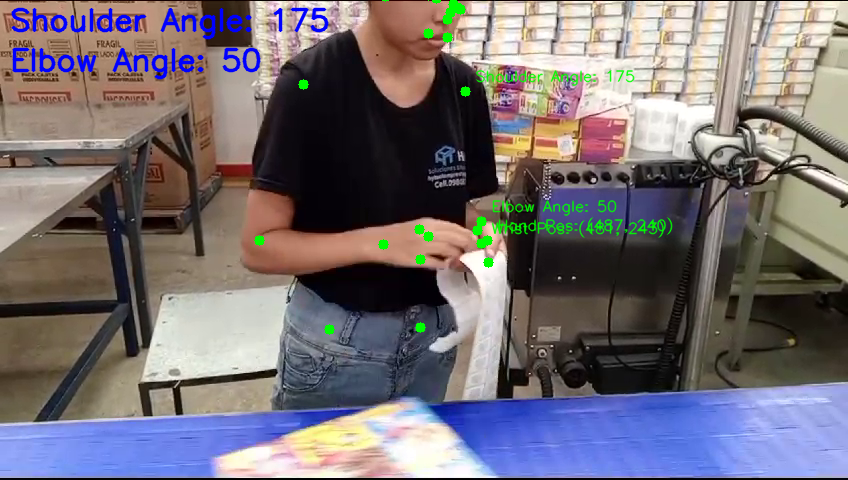

Frame 63:
  Shoulder Angle: 175.20302027117802
  Elbow Angle: 50.21609038603727
  Wrist Position: (0.5677666664123535, 0.5076485276222229, -0.3648851215839386)
  Hand Position: (0.5753988027572632, 0.5014435648918152, -0.43309369683265686)



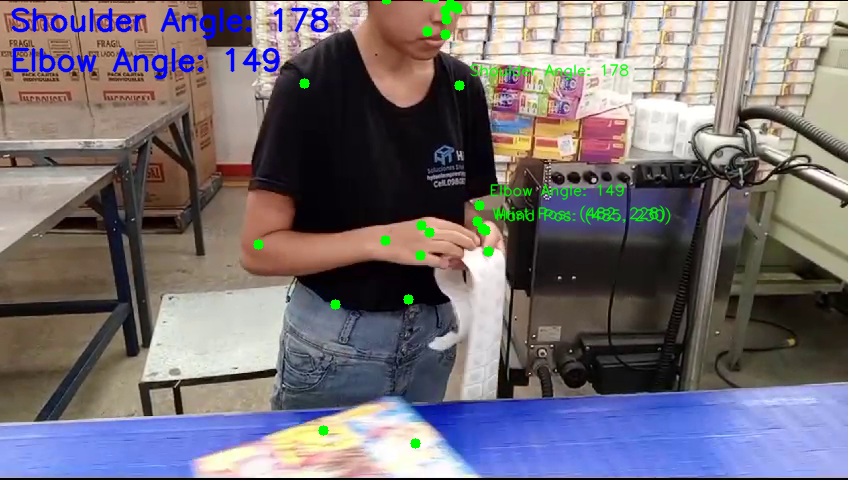

Frame 64:
  Shoulder Angle: 178.67892492690427
  Elbow Angle: 149.79249348699094
  Wrist Position: (0.5693579316139221, 0.475967139005661, -0.3828239440917969)
  Hand Position: (0.5728316903114319, 0.4810425043106079, -0.4686747193336487)



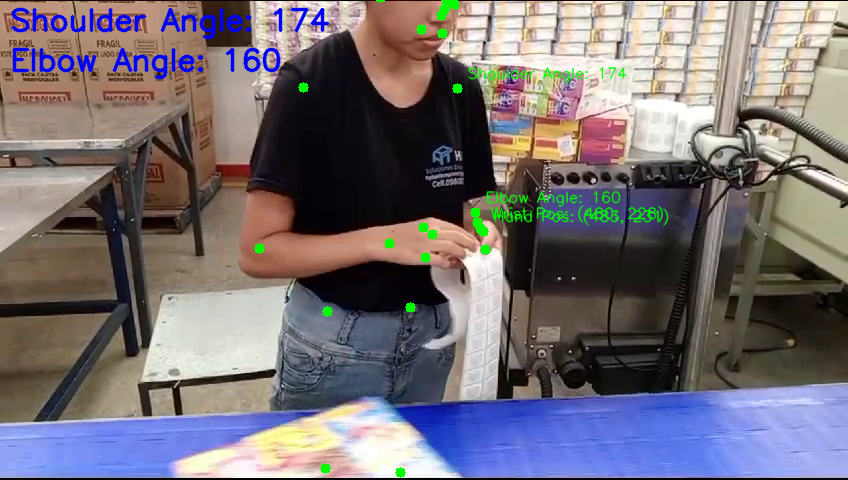

Frame 65:
  Shoulder Angle: 174.93622728995763
  Elbow Angle: 160.4631500221661
  Wrist Position: (0.5670769810676575, 0.4765106737613678, -0.4023439884185791)
  Hand Position: (0.5706145763397217, 0.48279905319213867, -0.4835686683654785)



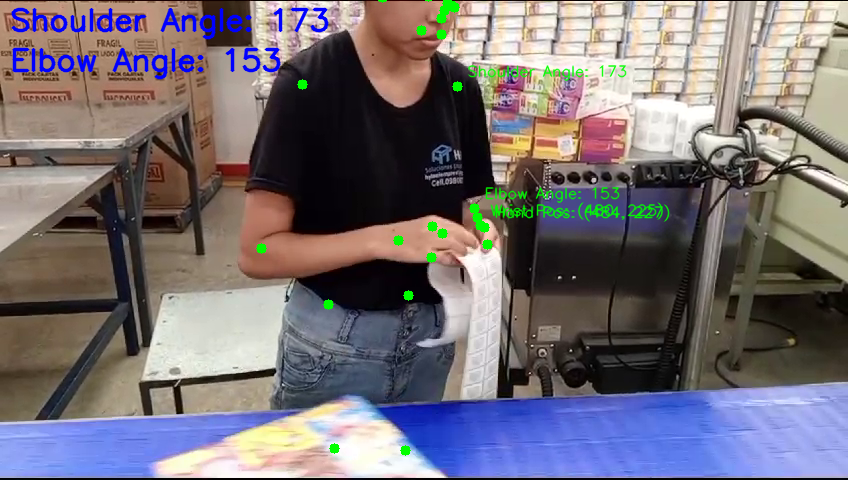

Frame 66:
  Shoulder Angle: 173.34445255971616
  Elbow Angle: 153.25559603321716
  Wrist Position: (0.5662418007850647, 0.46899229288101196, -0.4124721884727478)
  Hand Position: (0.5707900524139404, 0.47481605410575867, -0.4960691034793854)



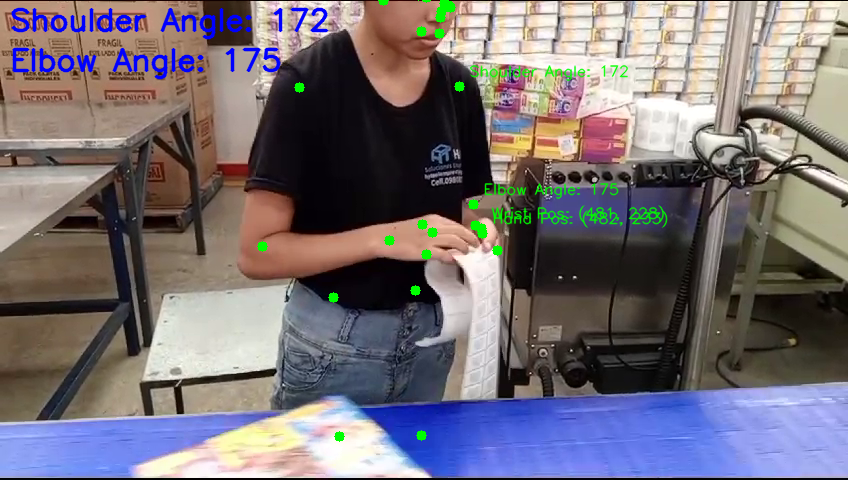

Frame 67:
  Shoulder Angle: 172.4614756521159
  Elbow Angle: 175.0255449053887
  Wrist Position: (0.5682883858680725, 0.4761948883533478, -0.5927701592445374)
  Hand Position: (0.569362998008728, 0.48572760820388794, -0.7049615979194641)



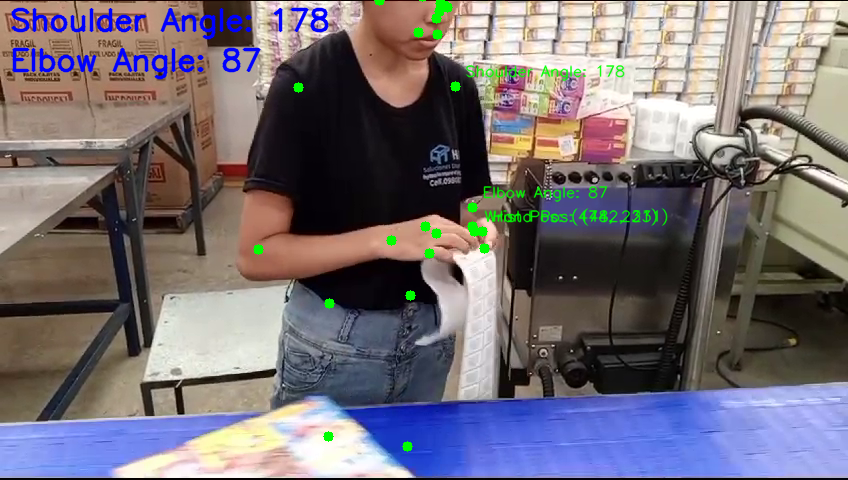

Frame 68:
  Shoulder Angle: 178.73527926891876
  Elbow Angle: 87.50374174057227
  Wrist Position: (0.5599735975265503, 0.48223593831062317, -0.4695824086666107)
  Hand Position: (0.5689402222633362, 0.4813220202922821, -0.5583409070968628)



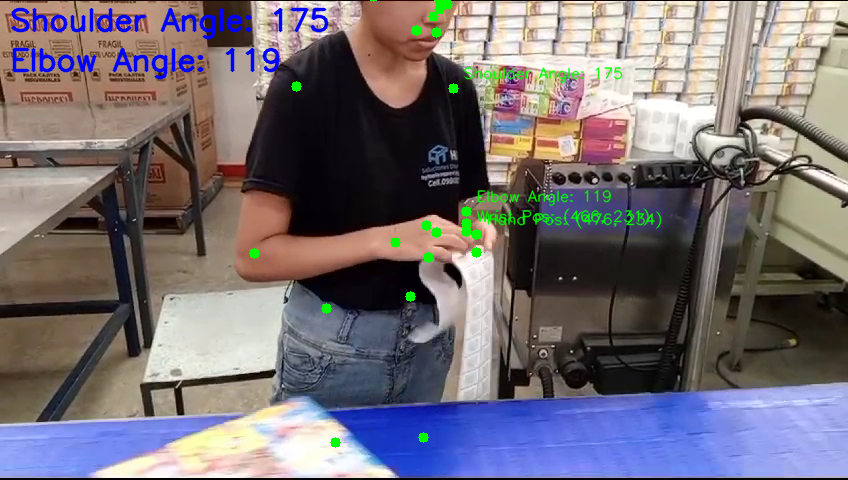

Frame 69:
  Shoulder Angle: 175.04798654709003
  Elbow Angle: 119.5293927618958
  Wrist Position: (0.5495790839195251, 0.48171266913414, -0.422339528799057)
  Hand Position: (0.5624229311943054, 0.4893932342529297, -0.5069125294685364)



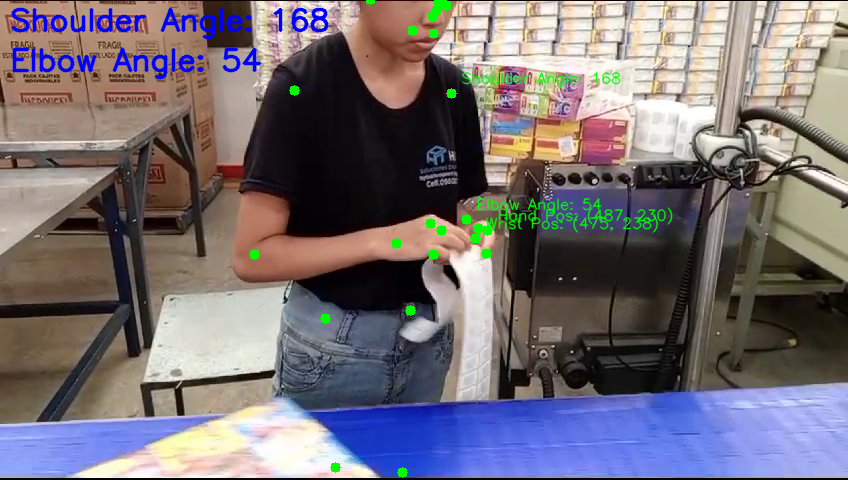

Frame 70:
  Shoulder Angle: 168.84172502503785
  Elbow Angle: 54.09579348551761
  Wrist Position: (0.5605475306510925, 0.49765875935554504, -0.4671371877193451)
  Hand Position: (0.5752023458480835, 0.47974857687950134, -0.5475004315376282)



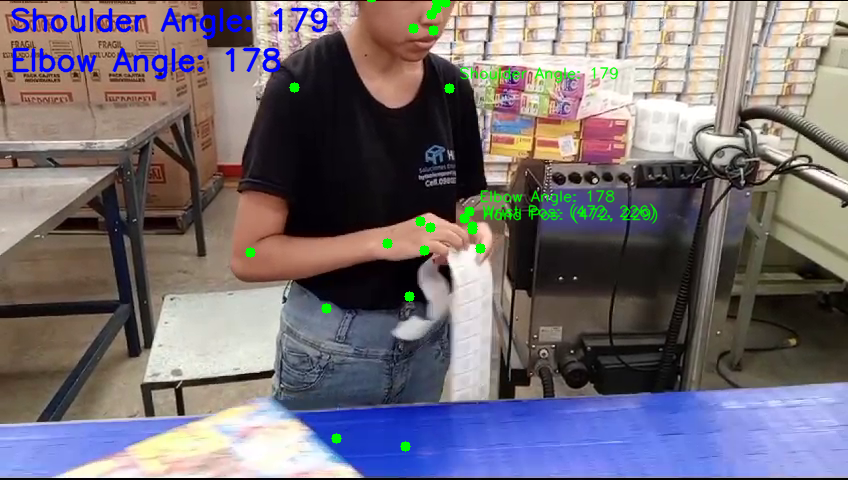

Frame 71:
  Shoulder Angle: 179.2943351361981
  Elbow Angle: 178.86379484874212
  Wrist Position: (0.5566884875297546, 0.4718405604362488, -0.3902117908000946)
  Hand Position: (0.5575290322303772, 0.47873032093048096, -0.465763121843338)



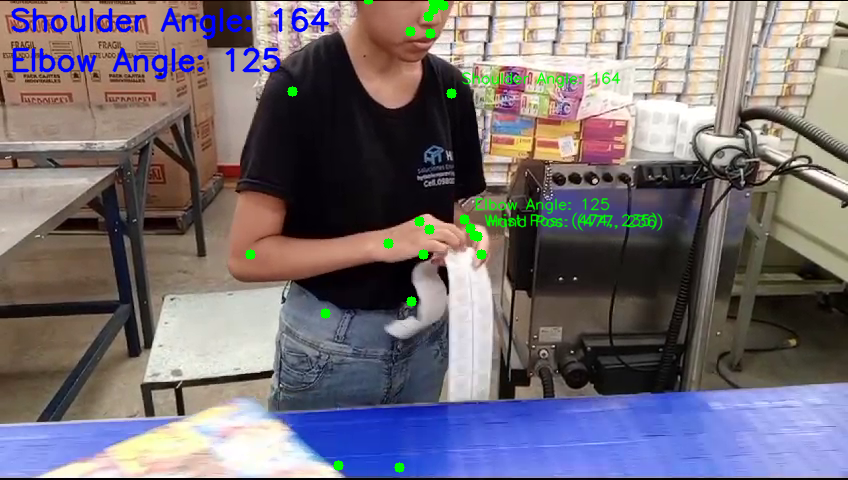

Frame 72:
  Shoulder Angle: 164.18526925887593
  Elbow Angle: 125.44800372046433
  Wrist Position: (0.5596184730529785, 0.4915917217731476, -0.44098371267318726)
  Hand Position: (0.5631778836250305, 0.49263566732406616, -0.5205479860305786)



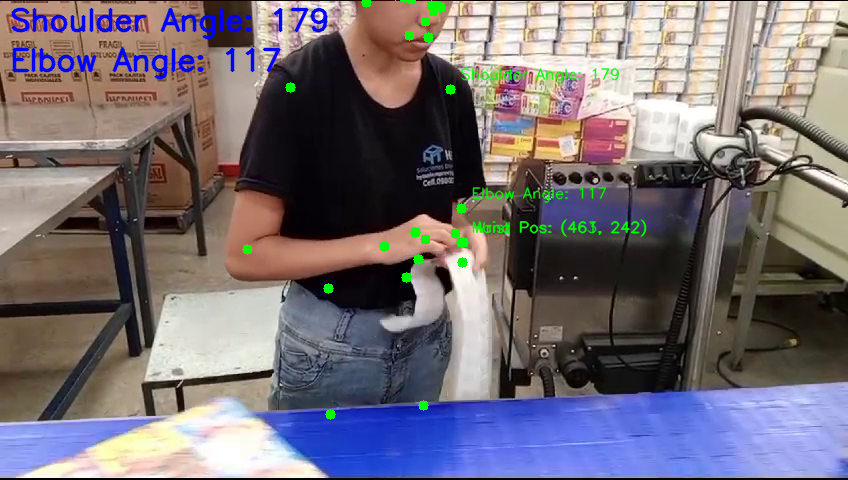

Frame 73:
  Shoulder Angle: 179.37539674608078
  Elbow Angle: 117.48532604837047
  Wrist Position: (0.546657383441925, 0.5042145252227783, -0.5861909985542297)
  Hand Position: (0.5446116328239441, 0.5053807497024536, -0.6831971406936646)



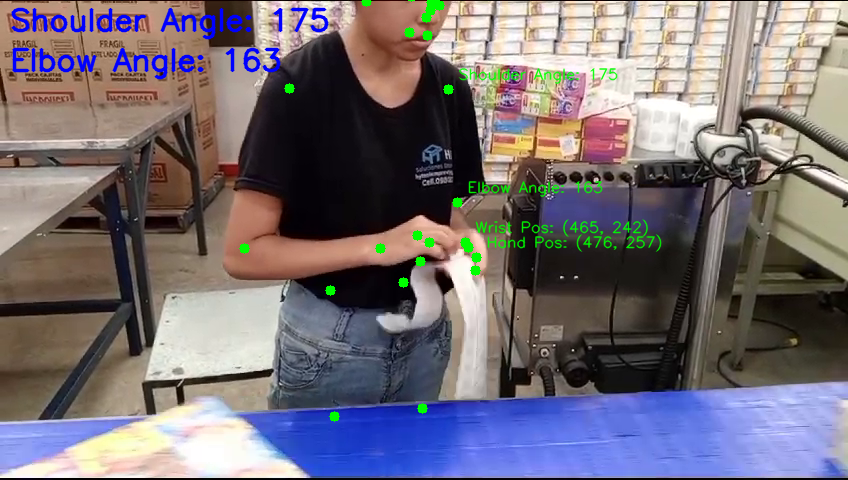

Frame 74:
  Shoulder Angle: 175.99617376563523
  Elbow Angle: 163.5794532841099
  Wrist Position: (0.5490376353263855, 0.5062499642372131, -0.5437239408493042)
  Hand Position: (0.5616018772125244, 0.5359148383140564, -0.647257924079895)



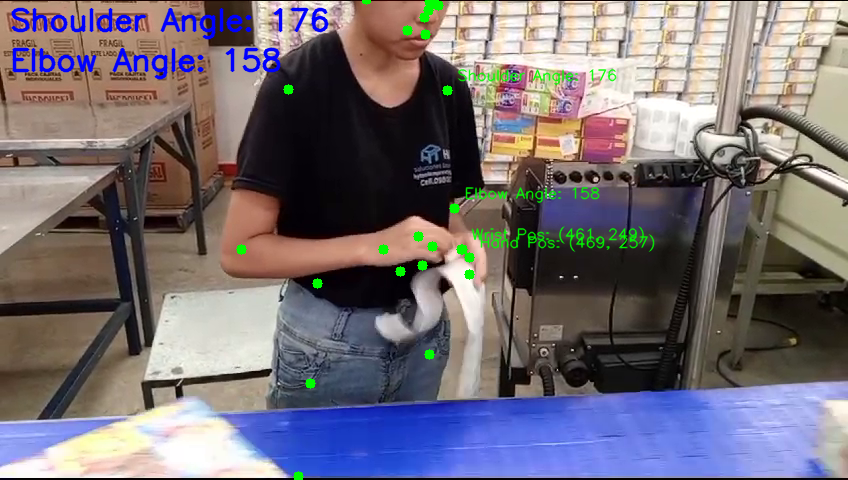

Frame 75:
  Shoulder Angle: 176.41963900011214
  Elbow Angle: 158.26161862810085
  Wrist Position: (0.5444074869155884, 0.5193379521369934, -0.5527660846710205)
  Hand Position: (0.5534384250640869, 0.5368953347206116, -0.6474072337150574)



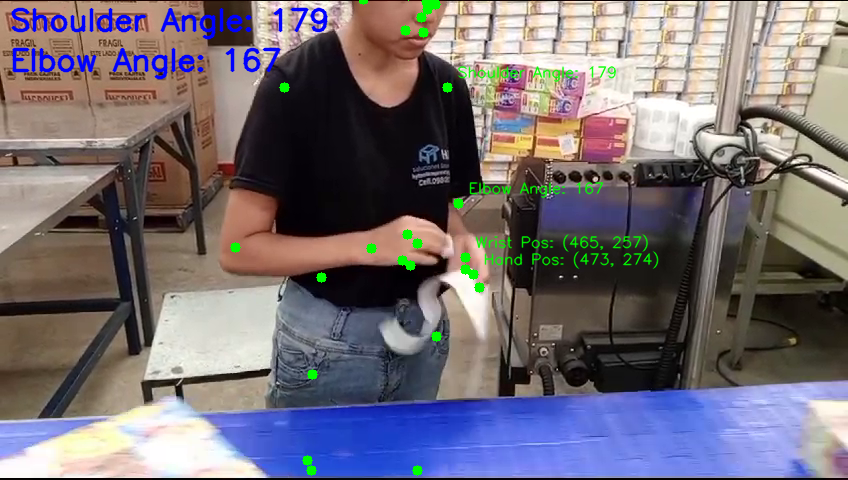

Frame 76:
  Shoulder Angle: 179.43401735441392
  Elbow Angle: 167.79711073617398
  Wrist Position: (0.5486409664154053, 0.5374099016189575, -0.5126928091049194)
  Hand Position: (0.5584519505500793, 0.5716380476951599, -0.6090118288993835)



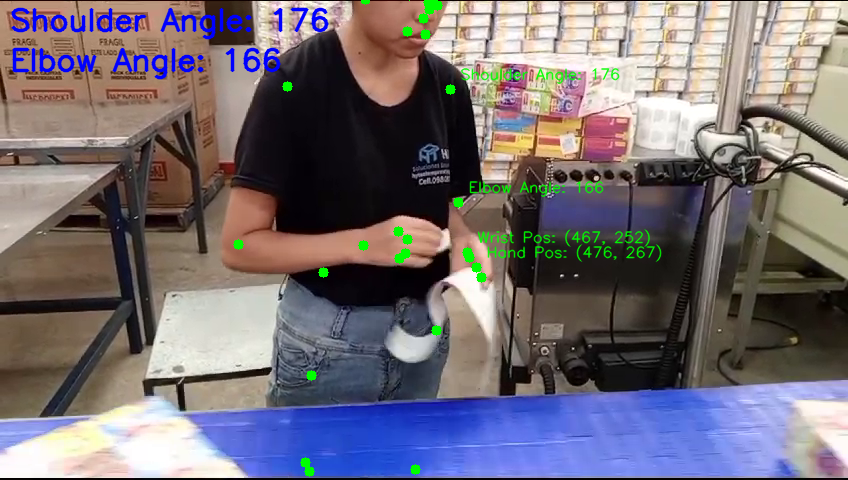

Frame 77:
  Shoulder Angle: 176.63071305800958
  Elbow Angle: 166.94091924382369
  Wrist Position: (0.5511109828948975, 0.5260444283485413, -0.6652175188064575)
  Hand Position: (0.5614417791366577, 0.5564938187599182, -0.7731143236160278)



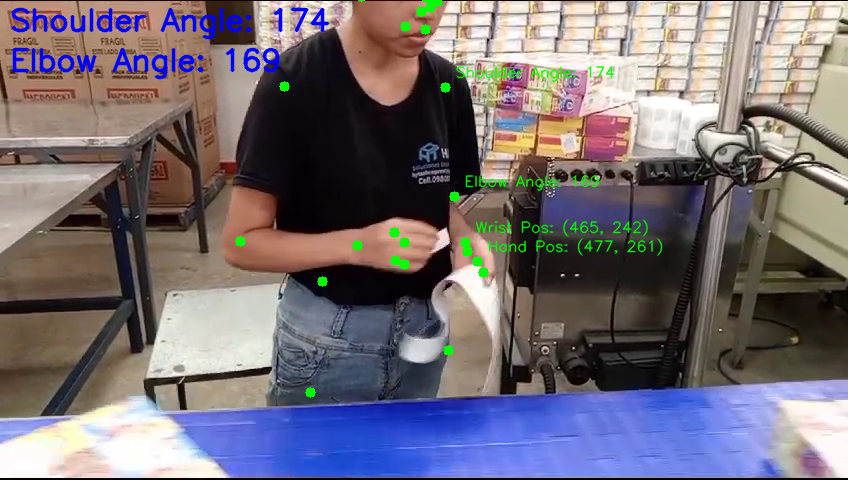

Frame 78:
  Shoulder Angle: 174.53415293504702
  Elbow Angle: 169.35790991894925
  Wrist Position: (0.5492652654647827, 0.5043987035751343, -0.6650257706642151)
  Hand Position: (0.563149094581604, 0.5454450249671936, -0.782027542591095)



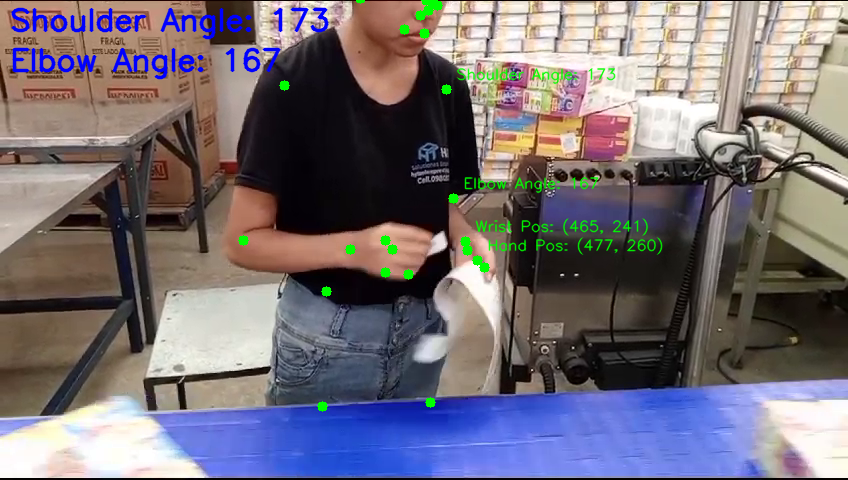

Frame 79:
  Shoulder Angle: 173.14572965598404
  Elbow Angle: 167.76007883178474
  Wrist Position: (0.5487532615661621, 0.5041533708572388, -0.6608598828315735)
  Hand Position: (0.5635949373245239, 0.5426066517829895, -0.788201630115509)



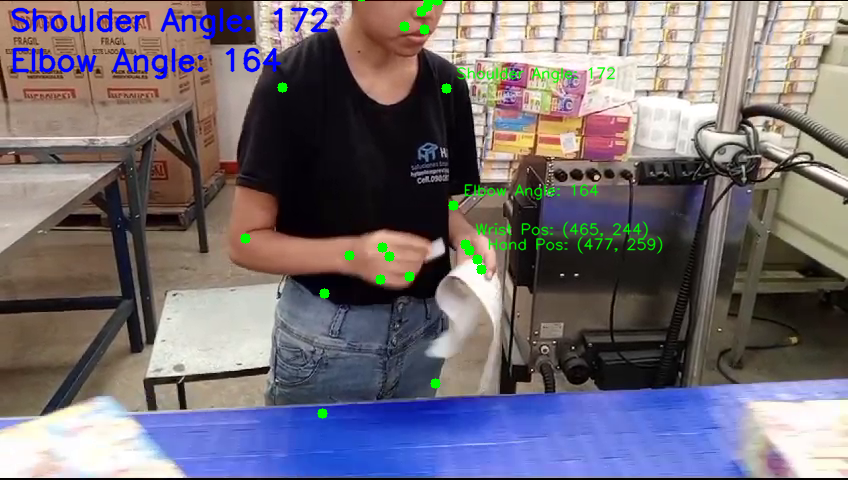

Frame 80:
  Shoulder Angle: 172.48047278045874
  Elbow Angle: 164.85156919803416
  Wrist Position: (0.5488142967224121, 0.5091410279273987, -0.630516529083252)
  Hand Position: (0.5628955364227295, 0.539880096912384, -0.7539490461349487)

Buffered data was truncated after reaching the output size limit.

In [ ]:
import cv2
import mediapipe as mp
import numpy as np

# Inicializar MediaPipe para detección de puntos clave
mp_drawing = mp.solutions.drawing_utils
mp_pose = mp.solutions.pose

# Función para calcular el ángulo entre tres puntos
def calculate_angle(a, b, c):
    a = np.array(a)  # Primer punto
    b = np.array(b)  # Segundo punto (vértice)
    c = np.array(c)  # Tercer punto

    radians = np.arctan2(c[1] - b[1], c[0] - b[0]) - np.arctan2(a[1] - b[1], a[0] - b[0])
    angle = np.abs(radians * 180.0 / np.pi)

    if angle > 180.0:
        angle = 360.0 - angle

    return angle

# Función para detectar puntos clave usando MediaPipe
def detect_keypoints(video_path):
    cap = cv2.VideoCapture(video_path)
    pose = mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5)
    keypoints_list = []
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        results = pose.process(image_rgb)
        if results.pose_landmarks:
            keypoints = [(lm.x, lm.y, lm.z) for lm in results.pose_landmarks.landmark]
            keypoints_list.append(keypoints)
        else:
            keypoints_list.append([])  # Agregar una lista vacía si no se detectan keypoints

    cap.release()
    pose.close()
    return keypoints_list

# Función para extraer puntos clave específicos y calcular ángulos
def analyze_keypoints(keypoints_list):
    analysis_results = []
    for keypoints in keypoints_list:
        if not keypoints:  # Si no hay keypoints detectados
            analysis_results.append({
                'shoulder_angle': None,
                'elbow_angle': None,
                'wrist_position': None,
                'hand_position': None,
                'keypoints': []
            })
            continue

        # Extraer puntos clave
        shoulder = keypoints[mp_pose.PoseLandmark.LEFT_SHOULDER.value]
        elbow = keypoints[mp_pose.PoseLandmark.LEFT_ELBOW.value]
        wrist = keypoints[mp_pose.PoseLandmark.LEFT_WRIST.value]
        hand = keypoints[mp_pose.PoseLandmark.LEFT_INDEX.value]

        # Calcular ángulos
        shoulder_angle = calculate_angle(shoulder, elbow, wrist)
        elbow_angle = calculate_angle(elbow, wrist, hand)

        analysis_results.append({
            'shoulder_angle': shoulder_angle,
            'elbow_angle': elbow_angle,
            'wrist_position': wrist,
            'hand_position': hand,
            'keypoints': keypoints
        })

    return analysis_results

# Función para visualizar los puntos clave en los frames
from google.colab.patches import cv2_imshow

def draw_keypoints_and_angles(video_path, analysis_results):
    cap = cv2.VideoCapture(video_path)
    for i in range(len(analysis_results)):
        ret, frame = cap.read()
        if not ret:
            break

        keypoints = analysis_results[i]['keypoints']
        shoulder_angle = analysis_results[i]['shoulder_angle']
        elbow_angle = analysis_results[i]['elbow_angle']

        # Dibujar puntos clave y conexiones con el color original
        if keypoints:
            for j, point in enumerate(keypoints):
                cv2.circle(frame, (int(point[0] * frame.shape[1]), int(point[1] * frame.shape[0])), 5, (0, 255, 0), -1)

                # Añadir texto con información relevante junto a cada punto
                info_text = ""
                if j == mp_pose.PoseLandmark.LEFT_SHOULDER.value:
                    info_text = f"Shoulder Angle: {int(shoulder_angle)}"
                elif j == mp_pose.PoseLandmark.LEFT_ELBOW.value:
                    info_text = f"Elbow Angle: {int(elbow_angle)}"
                elif j == mp_pose.PoseLandmark.LEFT_WRIST.value:
                    info_text = f"Wrist Pos: ({int(point[0] * frame.shape[1])}, {int(point[1] * frame.shape[0])})"
                elif j == mp_pose.PoseLandmark.LEFT_INDEX.value:
                    info_text = f"Hand Pos: ({int(point[0] * frame.shape[1])}, {int(point[1] * frame.shape[0])})"

                if info_text:
                    cv2.putText(frame, info_text,
                                (int(point[0] * frame.shape[1]) + 10, int(point[1] * frame.shape[0]) - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1, cv2.LINE_AA)

        # Dibujar ángulos en el frame
        cv2.putText(frame, f'Shoulder Angle: {int(shoulder_angle) if shoulder_angle else 0}',
                    (10, 30),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2, cv2.LINE_AA)

        cv2.putText(frame, f'Elbow Angle: {int(elbow_angle) if elbow_angle else 0}',
                    (10, 70),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2, cv2.LINE_AA)

        cv2_imshow(frame)

        # Imprimir información relevante en la consola
        print(f"Frame {i+1}:")
        print(f"  Shoulder Angle: {shoulder_angle}")
        print(f"  Elbow Angle: {elbow_angle}")
        print(f"  Wrist Position: {analysis_results[i]['wrist_position']}")
        print(f"  Hand Position: {analysis_results[i]['hand_position']}")
        print()

    cap.release()

# Ejemplo de uso:
video_path = videos[0]
keypoints_list = detect_keypoints(video_path)
analysis_results = analyze_keypoints(keypoints_list)
draw_keypoints_and_angles(video_path, analysis_results)


In [ ]:
# Función para exportar el video marcado
'''def export_marked_video(video_path, keypoints, output_path):
    cap = cv2.VideoCapture(video_path)
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))
    pose = mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5)
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        results = pose.process(image_rgb)
        if results.pose_landmarks:
            mp_drawing.draw_landmarks(frame, results.pose_landmarks, mp_pose.POSE_CONNECTIONS)
        out.write(frame)
    cap.release()
    out.release()

# Exportar el video marcado
video_name = os.path.basename(videos[0])
output_path = os.path.join('/content/drive/My Drive/Tesis/VideosMarcados', f'marked_{video_name}')
export_marked_video(videos[0], keypoints, output_path)'''


In [ ]:
import cv2
import os
from datetime import datetime

# Función para exportar el video marcado
def export_marked_video(video_path, output_directory):
    cap = cv2.VideoCapture(video_path)
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Obtener la fecha y hora actual
    now = datetime.now()
    timestamp = now.strftime("%Y%m%d_%H%M%S")

    # Extraer el nombre del archivo de video de entrada
    video_name = os.path.basename(video_path).split('.')[0]

    # Crear el nombre del archivo de video de salida
    output_video_name = f"{video_name}_{timestamp}.mp4"
    output_path = os.path.join(output_directory, output_video_name)

    # Crear el objeto VideoWriter para guardar el video
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))
    pose = mp_pose.Pose(static_image_mode=True, min_detection_confidence=0.5)
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        image_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        results = pose.process(image_rgb)
        if results.pose_landmarks:
            mp_drawing.draw_landmarks(frame, results.pose_landmarks, mp_pose.POSE_CONNECTIONS)
        out.write(frame)
    cap.release()
    out.release()
    pose.close()

    print(f"Video guardado como: {output_path}")

# Ruta del video de entrada
video_path = videos[0]  # Asegúrate de que 'videos' esté definida y contenga la ruta del video

# Ruta del directorio de salida
output_directory = '/content/drive/My Drive/Tesis/VideosMarcados'

# Exportar el video marcado
export_marked_video(video_path, output_directory)

In [ ]:
# Función para imprimir los datos de puntos clave relevantes para el Check List OCRA
def imprimir_datos_puntos_clave(keypoints):
    extremidades = {
        7: "Hombro Izquierdo",
        8: "Hombro Derecho",
        9: "Codo Izquierdo",
        10: "Codo Derecho",
        11: "Muñeca Izquierda",
        12: "Muñeca Derecha"
    }

    for i, puntos_clave_frame in enumerate(keypoints):
        print(f"Frame {i+1}:")
        for idx, extremidad in extremidades.items():
            print(f"{extremidad}: {puntos_clave_frame[idx]}")
        print("-" * 30)

# Mostrar los datos de puntos clave relevantes para el Check List OCRA en texto
imprimir_datos_puntos_clave(keypoints)

In [ ]:
import json
from datetime import datetime

# Función para guardar los datos en un archivo JSON
def save_keypoints_to_json(keypoints, video_name):
    extremities = {
        7: "Hombro Izquierdo",
        8: "Hombro Derecho",
        9: "Codo Izquierdo",
        10: "Codo Derecho",
        11: "Muneca Izquierda",
        12: "Muneca Derecha",
        13: "Mano Izquierda",
        14: "Mano Derecha"
    }

    data = []
    for i, frame_keypoints in enumerate(keypoints):
        frame_data = {"Frame": i+1, "PuntosClave": []}
        for idx in extremities:
            landmark = frame_keypoints[idx]
            extremity_name = extremities[idx]
            frame_data["PuntosClave"].append({"Extremidad": extremity_name, "Coordenadas": landmark})
        data.append(frame_data)

    # Nombre del archivo basado en la fecha y hora de exportación
    export_time = datetime.now().strftime("%Y%m%d_%H%M%S")
    json_filename = f"{video_name}_{export_time}.json"

    # Ruta completa donde se guardará el archivo JSON
    json_path = f"/content/drive/My Drive/Tesis/JSON/{json_filename}"

    # Guardar los datos en el archivo JSON
    with open(json_path, "w") as json_file:
        json.dump(data, json_file, indent=4)

    print(f"Datos guardados exitosamente en: {json_path}")

# Ejemplo de uso
# Suponiendo que 'keypoints' contiene los datos de los puntos clave como se ha procesado antes
video_name = video_name  # Cambiar por el nombre del video relevante
save_keypoints_to_json(keypoints, video_name)


In [ ]:
# Ejemplo de funciones para identificar pausas en un video
def detectar_pausas(video_path):
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print("Error al abrir el video")
        return

    # Configurar el detector de movimiento (puedes utilizar otros métodos según el caso)
    detector = cv2.createBackgroundSubtractorMOG2()

    pausas = []
    duracion_video = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) // int(cap.get(cv2.CAP_PROP_FPS))

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        # Preprocesamiento del frame para detectar movimiento (o cualquier otro método de detección)
        fgmask = detector.apply(frame)

        # Ejemplo de condición de detección de pausa (aquí debe ajustarse según tus criterios específicos)
        if np.mean(fgmask) < 2:  # Ejemplo: si el promedio de píxeles en movimiento es bajo, considerar pausa
            pausas.append(cap.get(cv2.CAP_PROP_POS_MSEC) / 1000)  # Tiempo en segundos

    cap.release()

    return pausas, duracion_video

In [ ]:
# Detectar pausas en el video
pausas, duracion_video = detectar_pausas(videos[0])

# Mostrar las pausas por pantalla
print("Pausas detectadas:")
for pausa in pausas:
    print(f"Tiempo de pausa: {pausa:.2f} segundos")

# Mostrar la duración total del video
print(f"Duración total del video: {duracion_video} segundos")


In [ ]:
import cv2
import os
import numpy as np
import json
from tensorflow.keras.models import load_model

# Ruta del modelo guardado
model_path = '/content/drive/My Drive/VideosErgo/modelo_factor_fuerza/modelo_factor_fuerza.h5'

# Cargar el modelo
modelo_factor_fuerza = load_model(model_path)

# Función para cargar los datos del JSON
def load_keypoints_data(json_path):
    with open(json_path, 'r') as json_file:
        keypoints_data = json.load(json_file)
    return keypoints_data

# Función para preparar los datos para la predicción
def prepare_data_for_prediction(keypoints_data):
    features = []
    for frame in keypoints_data:
        frame_features = []
        for punto_clave in frame['PuntosClave']:
            frame_features.extend(punto_clave['Coordenadas'])
        resized_frame_features = np.resize(np.array(frame_features), (224, 224, 3))
        features.append(resized_frame_features)
    return np.array(features)

# Función para realizar predicciones usando el modelo
def predict_force(features, model):
    predictions = model.predict(features)
    return predictions

# Función para identificar pausas en un video
def detectar_pausas_con_modelo(video_path, model, keypoints_json_path):
    print(f"Procesando video: {video_path}")
    print(f"Usando JSON: {keypoints_json_path}")

    # Cargar datos de puntos clave desde JSON
    keypoints_data = load_keypoints_data(keypoints_json_path)

    # Preparar datos para la predicción
    features = prepare_data_for_prediction(keypoints_data)

    # Realizar predicciones de fuerza
    force_predictions = predict_force(features, model)

    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print(f"Error al abrir el video {video_path}")
        return None

    pausas = []
    frame_rate = cap.get(cv2.CAP_PROP_FPS)
    frame_count = 0
    en_pausa = False
    pausa_inicio = None

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        # Obtener la predicción de fuerza para el frame actual
        if frame_count < len(force_predictions):
            fuerza = force_predictions[frame_count][0]

            # Si la fuerza es baja, considerar como posible pausa
            if fuerza < 0.1:  # Ajusta el umbral según sea necesario
                if not en_pausa:
                    en_pausa = True
                    pausa_inicio = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
            else:
                if en_pausa:
                    en_pausa = False
                    pausa_fin = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
                    pausas.append((pausa_inicio, pausa_fin))

        frame_count += 1

    # Capturar cualquier pausa que se haya iniciado pero no terminado
    if en_pausa:
        pausa_fin = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000
        pausas.append((pausa_inicio, pausa_fin))

    cap.release()

    duracion_video = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) // int(frame_rate)
    return pausas, duracion_video

In [ ]:
# Función para procesar todos los videos en una carpeta
def procesar_videos_en_carpeta(video_dir, model):
    for video_file in os.listdir(video_dir):
        if video_file.endswith('.mp4'):  # Puedes ajustar esto según el tipo de archivos de video que tengas
            video_path = os.path.join(video_dir, video_file)
            keypoints_json_path = os.path.join('/content/drive/My Drive/Tesis/JSON/etiquetado.mp4_20240701_215304.json', os.path.splitext(video_file)[0] + '.json')  # Cambia esto a la ruta de tu JSON correspondiente
            if os.path.isfile(video_path) and os.path.isfile(keypoints_json_path):
                pausas, duracion_video = detectar_pausas_con_modelo(video_path, model, keypoints_json_path)
                if pausas is not None:
                    # Mostrar las pausas por pantalla
                    print(f"Pausas detectadas en {video_file}:")
                    for inicio, fin in pausas:
                        print(f"Inicio: {inicio:.2f} segundos, Fin: {fin:.2f} segundos")

                    # Mostrar la duración total del video
                    print(f"Duración total del video: {duracion_video} segundos")
            else:
                print(f"Archivo de video o JSON no encontrado: {video_file}")

# Ruta de la carpeta de videos
video_dir = '/content/drive/My Drive/VideosErgo/VideoTest'

# Procesar todos los videos en la carpeta
procesar_videos_en_carpeta(video_dir, modelo_factor_fuerza)

In [ ]:
#pausas = [(100, 2), (50, 1.5), (80, 3)]

# Significado de cada tupla:
# (100, 2): Hubo una pausa de 100 minutos que ocurrió 2 veces.
# (50, 1.5): Hubo una pausa de 50 minutos que ocurrió 1.5 veces (posiblemente se redondee o ajuste según tus necesidades).
# (80, 3): Hubo una pausa de 80 minutos que ocurrió 3 veces.

# Interpretación:
# - La primera pausa ocurrió 2 veces y cada vez duró 100 minutos.
# - La segunda pausa ocurrió 1 vez y duró 50 minutos.
# - La tercera pausa ocurrió 3 veces y cada vez duró 80 minutos.


In [ ]:
def calcular_factor_recuperacion(frames, duracion_turno):
    duracion_total_pausas = 0

    # Suponiendo que tienes los datos de pausas en una estructura adecuada
    # Aquí simulo un cálculo ficticio con datos de ejemplo
    pausas = [(10, 5), (120, 10), (5, 10)]  # Ejemplo: (duración_pausa, cantidad)

    # Calcular la duración total de las pausas
    for duracion, cantidad in pausas:
        duracion_total_pausas += duracion * cantidad

    # Calcular el Factor de Recuperación (FR)
    fr = duracion_total_pausas / duracion_turno

    return fr

# Definir la ruta del archivo JSON ya exportado
json_path = "/content/drive/My Drive/Tesis/JSON/etiquetado.mp4_20240701_215304.json"

# Cargar los datos desde el JSON
with open(json_path, "r") as json_file:
    data = json.load(json_file)

# Acceder a los datos de los frames
frames = json_path # Suponiendo que "frames" es la clave donde están almacenados los datos de los frames

# Ahora puedes reutilizar los datos de los frames cargados desde el JSON
duracion_turno = 480  # Duración del turno en minutos (ejemplo)

factor_recuperacion = calcular_factor_recuperacion(frames, duracion_turno)
print(f"Factor de Recuperación (FR): {factor_recuperacion:.2f}")

In [ ]:
import json

def load_keypoints_from_json(json_path):
    with open(json_path, 'r') as json_file:
        data = json.load(json_file)
    return data

In [ ]:
def calculate_cycle_frequency_and_duration(keypoints_data):
    frequency = 0  # Inicializa la frecuencia del ciclo
    cycle_duration = 0  # Inicializa la duración del ciclo

    # Variables para almacenar el tiempo del ciclo y los cambios en la posición
    last_time = None
    last_positions = {}

    # Itera sobre los frames de keypoints_data
    for frame_data in keypoints_data:
        frame_number = frame_data['Frame']
        keypoints = frame_data['PuntosClave']

        # Calcula la frecuencia del ciclo basada en cambios en las extremidades relevantes
        # (Hombros, Codos, Muñecas y Manos)
        current_positions = {keypoint['Extremidad']: keypoint['Coordenadas'] for keypoint in keypoints}

        if last_time is not None and last_positions:
            # Calcula el tiempo transcurrido desde el último frame (en segundos)
            current_time = frame_number * 1 / 20  # 10 frames por segundo (ejemplo)
            cycle_duration = current_time - last_time

            # Calcula la frecuencia como inversa del cycle_duration (ciclos por segundo)
            if cycle_duration > 0:
                frequency = 1 / cycle_duration

        # Actualiza los últimos registros de tiempo y posiciones
        last_time = frame_number * 1 / 30  # Actualiza el último tiempo registrado (ejemplo)
        last_positions = current_positions

    return frequency, cycle_duration

# Ruta al archivo JSON
json_path = "/content/drive/My Drive/Tesis/JSON/etiquetado.mp4_20240701_215304.json"

# Cargar datos desde el archivo JSON
with open(json_path, 'r') as json_file:
    keypoints_data = json.load(json_file)

# Calcular la frecuencia del ciclo y la duración del ciclo
frequency, cycle_duration = calculate_cycle_frequency_and_duration(keypoints_data)

# Imprimir los resultados
print(f"Frecuencia del Ciclo: {frequency} ciclos por segundo")
print(f"Duración del Ciclo: {cycle_duration} segundos")

In [ ]:
import numpy as np
import json
from tensorflow.keras.models import load_model

# Ruta del modelo guardado
model_path = '/content/drive/My Drive/VideosErgo/modelo_factor_fuerza/modelo_factor_fuerza.h5'

# Cargar el modelo
modelo_factor_fuerza = load_model(model_path)

# Función para cargar los datos del JSON
def load_keypoints_data(json_path):
    with open(json_path, 'r') as json_file:
        keypoints_data = json.load(json_file)
    return keypoints_data

# Función para preparar los datos para la predicción
def prepare_data_for_prediction(keypoints_data):
    # Prepara tus datos según las características que el modelo espera
    # Aquí deberás extraer y formatear los puntos clave necesarios
    # Asegúrate de que la salida tenga la forma (None, 224, 224, 3)
    features = []
    for frame in keypoints_data:
        frame_features = []
        for punto_clave in frame['PuntosClave']:
            frame_features.extend(punto_clave['Coordenadas'])
        # Necesitas redimensionar o procesar frame_features para que coincida con (224, 224, 3)
        # Ejemplo (reemplaza esto con la lógica correcta para tu caso):
        resized_frame_features = np.resize(np.array(frame_features), (224, 224, 3))
        features.append(resized_frame_features)
    return np.array(features)

# Función para realizar predicciones usando el modelo
def predict_force(features, model):
    predictions = model.predict(features)
    return predictions

# Ejemplo de uso
json_path = '/content/drive/My Drive/Tesis/JSON/etiquetado.mp4_20240701_215304.json'  # Cambia esto a la ruta de tu JSON
keypoints_data = load_keypoints_data(json_path)
features = prepare_data_for_prediction(keypoints_data)  # Asegúrate de que 'features' tenga la forma correcta
force_predictions = predict_force(features, modelo_factor_fuerza)

# Procesar y mostrar las predicciones
for i, prediction in enumerate(force_predictions):
    print(f"Predicción de Fuerza para Frame {i+1}: {prediction[0]:.2f}")

# Función para calcular el Factor de Frecuencia (FF)
def calcular_factor_frecuencia(frecuencia_ciclos, duracion_ciclo):
    factor_frecuencia = frecuencia_ciclos / duracion_ciclo
    return factor_frecuencia

# Ejemplo de uso de la función para calcular el Factor de Frecuencia
frecuencia_ciclos = frequency  # Ejemplo de frecuencia de ciclos por segundo
duracion_ciclo = cycle_duration  # Duración promedio de un ciclo en segundos

factor_frecuencia = calcular_factor_frecuencia(frecuencia_ciclos, duracion_ciclo)
print(f"Factor de Frecuencia (FF): {factor_frecuencia:.2f}")

In [ ]:
from google.colab import drive
drive.mount('/content/drive')